# LANGUAGE COMPETENCE PART 3: EDA

This notebook contains my exploratory data analysis with the aim being to to understand which variables could have an impact on the students' test results and ultimately to decide which features to include in the modelling phase of the project.

## Data Source

European Survey on Language Competences (ESLC) conducted by the Centre for Research on Education and Lifelong Learning: https://crell.jrc.ec.europa.eu/?q=article/eslc-database

The European Survey on Language Competences (ESLC) was carried out in 2012 to provide the Commission and the participant countries comparable data - across skills and languages – of foreign language competences of secondary school students. The data collected in the 16 participating educational systems includes the results of language tests according to the Common European Framework of Reference (CEFR) and the results of the different administered questionnaires.

The test results correspond to the first and the second most commonly taught languages in the participating educational systems and the questionnaire data includes student, teacher and school/principal responses to information pertaining to teaching and learning. For this project I will concentrate on the student-specific data and only refer to the teacher/school-specific data for context.

## Data Format

Scoring:

- Language tests have been scored according to the Common European Framework of Reference for Languages (https://en.wikipedia.org/wiki/Common_European_Framework_of_Reference_for_Languages). As an initial approach I will evaluate whether it is appropriate to group each specific level into a broader category by discipline (listening, reading, writing).

## Import Data

In [1]:
import pandas as pd
from sklearn.preprocessing import Imputer
from tqdm import tqdm
import seaborn as sns
sns.set_style("whitegrid")
pd.set_option('display.max_rows',None)

In [98]:
# import data
lang = pd.read_csv("/Users/lizspiking/DataScience/language-competence/lang.csv")

In [99]:
lang.shape

(51861, 502)

In [100]:
lang.head()

,country_id,school_id,main_study_sample,respondent_id,targetLanguage_id,TL,questLanguage_id,TESTING_grade,test_mode,SQt01i01,SQt02i01C,SQt03i01,SQt04i00,SQt04i01,SQt04i02,SQt04i03,SQt04i04,SQt04i05,SQt04i06,SQt04i07,SQt04i08,SQt04i09,SQt04i10,SQt04i11,SQt04i12,SQt05i01,SQt05i01TC,SQt06i01,SQt09i01,SQt12i01,SQt13i01,SQt14i01,SQt15i01,SQt16i01,SQt17i01,SQt18i01,SQt19i01,SQt19i02,SQt19i03,SQt19i04,SQt19i05,SQt19i06,SQt19i07,SQt19i08,SQt20i01,SQt20i02,SQt20i03,SQt20i04,SQt20i05,SQt20i06,SQt20i07,SQt20i08,SQt21i01,SQt22i01,SQt22i02,SQt22i03,SQt22i04,SQt22i05,SQt23i01,SQt23i02,SQt23i03,SQt23i04,SQt23i05,SQt23i06,SQt23i07,SQt23i08,SQt23i09,SQt24i01,SQt24i02,SQt24i03,SQt24i04,SQt24i05,SQt24i06,SQt25i00,SQt25i01,SQt25i02,SQt25i03,SQt25i04,SQt25i05,SQt25i06,SQt25i07,SQt25i08,SQt25i09,SQt25i10,SQt25i11,SQt25i12,SQt26i00,SQt26i01,SQt26i02,SQt26i03,SQt26i04,SQt26i05,SQt26i06,SQt26i07,SQt26i08,SQt26i09,SQt26i10,SQt26i11,SQt26i12,SQt27i01,SQt28i01,SQt28i02,SQt29i01,SQt29i02,SQt29i03,SQt29i04,SQt29i05,SQt29i06,SQt29i07,SQt30i01,SQt30i02,SQt30i03,SQt30i04,SQt30i05,SQt30i06,SQt31i01,SQt31i02,SQt31i03,SQt31i04,SQt31i05,SQt31i06,SQt31i07,SQt31i08,SQt31i09,SQt32i01,SQt32i02,SQt32i03,SQt32i04,SQt33i01,SQt33i02,SQt33i03,SQt33i04,SQt33i05,SQt33i06,SQt33i07,SQt33i08,SQt33i09,SQt33i10,SQt34i01,SQt34i02,SQt34i03,SQt34i04,SQt34i05,SQt34i06,SQt34i07,SQt34i08,SQt34i09,SQt35i01,SQt35i02,SQt35i03,SQt35i04,SQt35i05,SQt35i06,SQt35i07,SQt35i08,SQt35i09,SQt36i01,SQt36i02,SQt36i03,SQt36i04,SQt36i05,SQt36i06,SQt36i07,SQt36i08,SQt36i09,SQt37i00,SQt37i01,SQt37i02,SQt37i03,SQt37i04,SQt37i05,SQt37i06,SQt37i07,SQt37i08,SQt37i09,SQt37i10,SQt38i01,SQt39i00,SQt39i01,SQt39i02,SQt39i03,SQt39i04,SQt39i05,SQt39i06,SQt39i07,SQt39i08,SQt39i09,SQt39i10,SQt39i11,SQt39i12,SQt39i13,SQt39i14,SQt40i00,SQt40i01,SQt40i02,SQt40i03,SQt40i04,SQt40i05,SQt40i06,SQt40i07,SQt40i08,SQt40i09,SQt40i10,SQt40i11,SQt40i12,SQt40i13,SQt40i14,SQt41i01,SQt42i01,SQt42i01C,SQt43i01,SQt43i01C,SQt44i01,SQt44i01C,SQt44i02,SQt44i02C,SQt44i03,SQt44i03C,SQt45i01,SQt45i02,SQt45i03,SQt45i04,SQt45i05,SQt45i06,SQt46i01,SQt46i02,SQt46i03,SQt46i04,SQt46i05,SQt46i06,SQt46i07,SQt47i01,SQt48i01,SQt48i02,SQt48i03,SQt48i04,SQt48i05,SQt48i06,SQt48i07,SQt49i01,SQt49i02,SQt50i01,SQt50i02,SQt50i03,SQt51i01,SQt51i02,SQt51i03,SQt51i04,SQt51i05,SQt51i06,SQt51i07,SQt51i08,SQt51i09,SQt52i01,SQt52i02,SQt52i03,SQt52i04,SQt52i05,SQt52i06,SQt52i07,SQt53i01,SQt53i02,SQt53i03,SQt53i04,SQt53i05,SQt53i06,SQt54i01,SQt54i02,SQt54i03,SQt54i04,SQt54i05,SQt54i06,SQt55i01,SQt55i02,SQt55i03,SQt55i04,SQt55i05,SQt55i06,SQt56i01,SQt56i02,SQt57i01,SQt57i02,SQt57i03,SQt57i04,SQt57i05,SQt57i06,SQt57i07,SQt58i01,SQt58i02,SQt58i03,SQt58i04,SQt58i05,SQt58i06,SQt58i07,SQt59i01,SQt59i02,SQt60i01,SQt61i01,SQt61i02,SQt61i03,SQt61i04,SQt61i05,SQt61i06,SQt61i07,SQt62i01,SQt62i02,SQt62i03,SQt62i04,SQt62i05,SQt62i06,SQt62i07,SQt62i08,SQt62i09,SQt63i01,SQt63i02,SQt64i01,SQt64i02,SQt64i03,SQt64i04,SQt64i05,SQt64i06,SQtA1i01,SQtA1i02,SQtA1i03,SQtA1i04,SQtA2i01,SQtA2i02,SQtA2i03,SQtA2i04,SQtA3i01,SQtA3i02,SQtA3i03,SQtA3i04,SQtA4i01,SQtA4i02,SQtA4i03,SQtA4i04,ISCO_M,ISCO_F,ISEI_M,ISEI_F,HISEI,MPARED,FPARED,PARED,HOMEPOS,I01_ST_M_S39A,I01_ST_M_S39B,I01_ST_M_S40A,I01_ST_M_S40B,I01_ST_M_S44A,I01_ST_M_S44B,I01_ST_M_S59A,I01_ST_M_S63A,I01_ST_M_S63B,I02_ST_M_S37A,I02_ST_M_S37B,I02_ST_M_S38A,I02_ST_M_S41A,I03_ST_A_S03A,I03_ST_A_S04A,I03_ST_A_S04B,I03_ST_A_S25A,I03_ST_A_S25B,I03_ST_A_S26A,I03_ST_A_S26B,I03_ST_A_S27B,I03_ST_A_S28A,I03_ST_A_S29A,I03_ST_A_S30A,I03_ST_A_S31A,I03_ST_A_S45A,I04_ST_M_S64A,I04_ST_M_S64B,I05_ST_A_S23A,I05_ST_A_S24A,I05_ST_M_S62A,I06_ST_M_S45A,I06_ST_M_S46A,I08_ST_A_S01A,I08_ST_A_S02A,I08_ST_A_S15A,I08_ST_A_S19B,I08_ST_M_S64A,I08_ST_M_S64B,I09_IN_M_S49A,I09_IN_M_S50A,I09_IN_M_S51A,I09_IN_M_S57A,I09_ST_M_S33B,I09_ST_M_S48A,I09_ST_M_S52B,I14_IN_A_S42A,I14_ST_A_S06A,I14_ST_A_S06B,I14_ST_A_S06C,I14_ST_M_S47A,PV1_LIST,PV2_LIST,PV3_LIST,PV4_LIST,PV5_LIST,PV1_READ,PV2_READ,PV3_READ,PV4_READ,PV5_READ,PV1_WRIT1,PV2_WRIT1,PV3_WRIT1,PV4_WRIT1,PV5_WRIT1,PV1_WRIT

## Drop Columns with High Proportion of Missing Values

In [101]:
# drop any columns with all missing values
lang.dropna(axis=1, how='all', inplace=True)

DECISION:
On the basis that more than 20% of the values in the following columns are missing, I will drop these columns as I don't believe I will get reliable data by imputing values:
- SQt04i01
- SQt04i02
- SQt04i03
- SQt04i04
- SQt25i01
- SQt25i02
- SQt25i03
- SQt25i04
- SQt26i01
- SQt26i02
- SQt26i03
- SQt26i04
- SQt37i07
- SQt37i08
- SQt37i09
- SQt39i00
- SQt39i01
- SQt39i02
- SQt39i03
- SQt39i04
- SQt40i00
- SQt40i01
- SQt40i02
- SQt40i03
- SQt40i04

In [102]:
# set list of columns to drop
drop_columns = ['SQt04i01','SQt04i02','SQt04i03','SQt04i04','SQt04i08',\
                'SQt04i10','SQt25i01','SQt25i02','SQt25i03','SQt25i04',\
                'SQt25i08','SQt25i10','SQt26i01','SQt26i02','SQt26i03',\
                'SQt26i04','SQt26i08','SQt26i10','SQt37i05','SQt37i06',\
                'SQt37i07','SQt37i08','SQt37i09','SQt39i00','SQt39i01',\
                'SQt39i03','SQt39i04','SQt40i00','SQt40i01','SQt40i03',\
                'SQt40i04']

In [103]:
# drop columns from df
lang.drop(drop_columns, axis=1, inplace=True)

In [104]:
lang.shape

(51861, 469)

DECISION: On the basis that less than 20% of the values in the remaining columns are missing, I will leave these in place for the moment. For the columns that I keep, I will impute values with either the mean, mode or 0, depending on what makes sense for that feature.

## Drop Weighted Columns

There are some weightings already attributed to the results in the df but as I do not have the detail of how they have been calculated, I would prefer to drop these and calculate my own if necessary, otherwise I risk not being able to explain how they were reached.

In [105]:
# create list of replicate_weight columns
replicate_weight = [col for col in lang.columns if 'RPW' in col or 'FSW' in col]

In [106]:
# save replicate weight data in case I need it later
replicate_weights = lang[replicate_weight].copy()

In [107]:
# drop replicate_weight columns from main df
lang.drop(replicate_weight, axis=1, inplace=True)

## Drop Plausible Value Columns

Similarly to the weightings, plausible values have been calculated in the df but I do not have the detail of how they have been calculated so I will drop these columns as I risk having results that I can't explain if I keep them in. Also, as they have most likely been calculated from the plausible levels which I am using as my targets, I expect them to be strongly correlated and to skew my model results if I leave them in.

In [108]:
# separate plausible values and drop from main df
results_pv = [col for col in lang.columns if 'PV' in col]

In [109]:
# subset to continuous results
plausible = lang.loc[:, results_pv].copy()
lang.drop(results_pv, axis=1, inplace=True)

## Drop Additional Columns

There are a number of columns in the df which are tracking information which should not logically correlate with my targets so I will drop those here. The country_id is useful but having the full country name would make things clearer so I will translate this to the full country name before dropping the id column.

In [110]:
# create dictionary of country codes and names
country_codes = tuple(lang['country_id'].unique())
country_names = ('Portugal', 'Greece', 'Belgium (Flemish)',\
                 'Spain', 'Belgium (French)', 'Slovenia',\
                 'Malta', 'Sweden', 'Poland', 'Croatia',\
                 'Estonia', 'UK', 'Belgium (German)',\
                 'Bulgaria', 'Netherlands', 'France')

In [111]:
# combine into dictionary and map to new column in df
countries = {code:country for code,country in zip(country_codes,country_names)}
lang['country'] = lang['country_id'].map(countries)

In [112]:
# drop columns that will not logically contribute to any predictions
# or which have a clearer equivalent
for_deletion = ['country_id','main_study_sample','respondent_id',\
                'targetLanguage_id','version_stu','JKzone','JKrep']

lang.drop(for_deletion, axis=1, inplace=True)

## Set Data Types

Due to the categorical nature of my data, there are many features that aren't the most appropriate data type for me to work with going forward. I will review the types and amend as appropriate.

In [113]:
# convert DOB field to datetime
lang['SQt02i01C'] = pd.to_datetime(lang['SQt02i01C'])

In [114]:
# separate out birth month and assign to seasons
lang['SQt02i01C_month'] = lang['SQt02i01C'].dt.month

lang['SQt02i01C_month'] = lang['SQt02i01C_month'].map(lambda x: 'Summer' if 6<=x<=8 
                                                                 else 'Autumn' if 9<=x<=11
                                                                 else 'Winter' if x==12
                                                                 else 'Winter' if 1<=x<=2
                                                                 else 'Spring')

In [115]:
# drop full DOB column
lang.drop('SQt02i01C', axis=1, inplace=True)

In [116]:
# clean empty strings in HISEI column and convert to float
lang.loc[lang['HISEI']=='  ','HISEI'] = np.nan

lang['HISEI'] = lang['HISEI'].map(lambda x: float(x))

In [117]:
# clarify language codes & names
lang_codes = tuple(lang['questLanguage_id'].unique())
lang_names = ('Portuguese','Greek','Norwegian','Spanish','French',\
              'Spanish','Slovenian','Unknown','Maltese','Swedish',\
              'Polish','Croatian','Estonian','English','Bengali',\
              'Bulgarian','Unknown','Dutch','French','Arabic','Arabic')

# create dictionary to use for mapping
lang_dict = {code:name for code,name in zip(lang_codes,lang_names)}

# map full language names to DF
lang['questLanguage_id'] = lang['questLanguage_id'].map(lang_dict)

In [118]:
# clarify test mode field
test_mode_dict = {'PB':'Paper', 'CB':'PC'}

# map full names to DF
lang['test_mode'] = lang['test_mode'].map(test_mode_dict)

In [119]:
lang.shape

(51861, 389)

## Evaluate Distribution of Categorical Results

In [120]:
# create lists of columns for each of the three test disciplines
cols = lang.columns
writing = [col for col in cols if 'WRIT' in col and 'PL' in col]
reading = [col for col in cols if 'READ' in col and 'PL' in col]
listening = [col for col in cols if 'LIST' in col and 'PL' in col]

In [121]:
# create list of columns the three test disciplines together
combined = [col for col in cols if 'PL' in col]

As the writing discipline has three times the features of the other two disciplines, if a student was not tested on writing then their most frequent result will be 'Not Tested' and so they won't get an overall level across multiple disciplines. To avoid this, I will populate the 'PL_ALL' column for those students with the mode from the other two disciplines, rather than across all 25 results columns.

In [122]:
# function to fill na values in specific columns with 'Not Tested'
def fill_nan(columns):
    for col in columns:
        lang[col].fillna('Not Tested', inplace=True)

In [123]:
# replace nan values in categorical results columns
fill_nan(reading)
fill_nan(listening)
fill_nan(writing)

In [124]:
# subset listening, reading and writing levels to allow for easier chart creation
reading_cat = lang.loc[:,reading]
listening_cat = lang.loc[:,listening]
writing_cat = lang.loc[:,writing]

In [125]:
# check shape of each discipline subset
print(writing_cat.shape, listening_cat.shape, reading_cat.shape)

(51861, 15) (51861, 5) (51861, 5)


In [126]:
# function to plot categorical results data for multiple results columns
def scores_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,20))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(5,3,j)
        plt.title('Scores for ' + str(i))
        sns.countplot(x=i, data=data)
        #plt.set_ylabel('Frequency')
        #plt.xticks(range(len(writing_cat)),writing_cat[i],rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('CEFRL Scores', fontsize=20)
    plt.show()

#### Action
Remove extraneous code/comments from scores_fig function

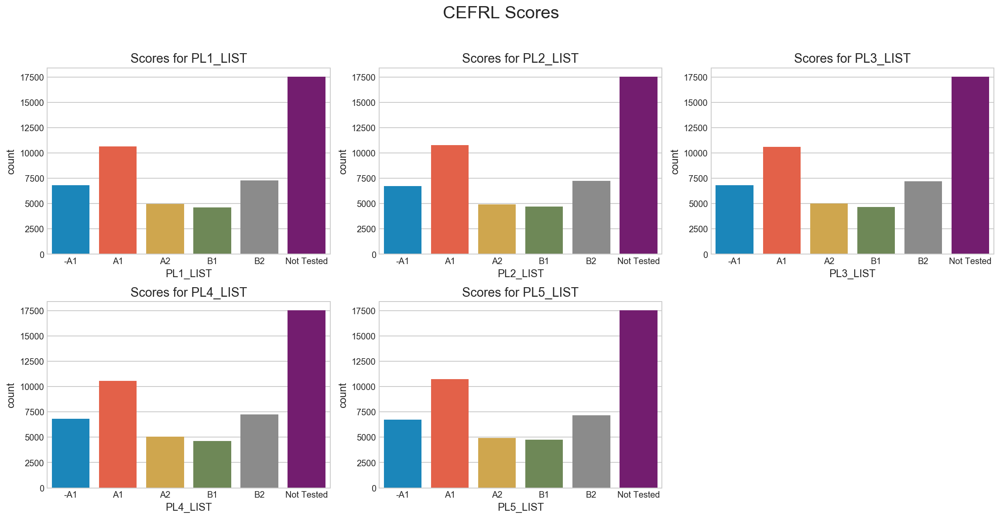

In [127]:
# plot listening scores
scores_fig(listening_cat)

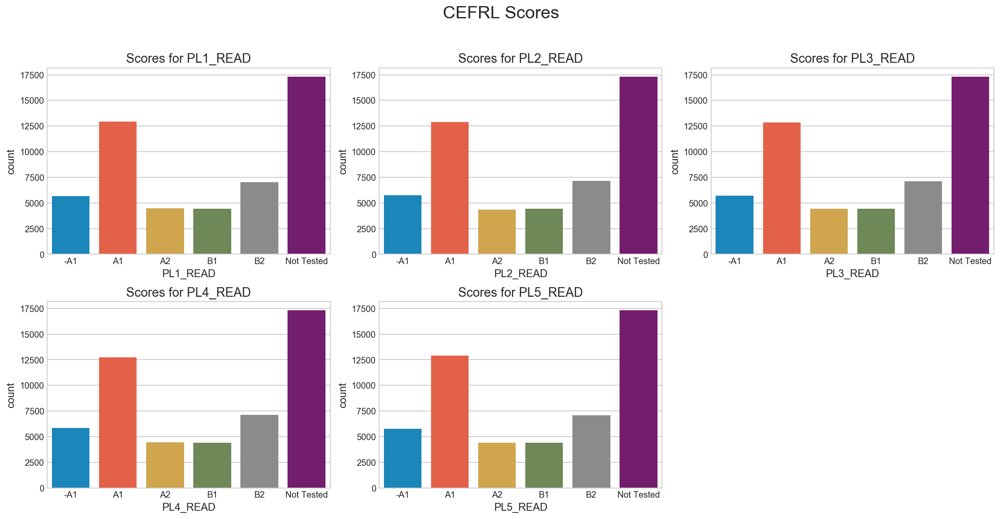

In [128]:
# plot reading scores
scores_fig(reading_cat)

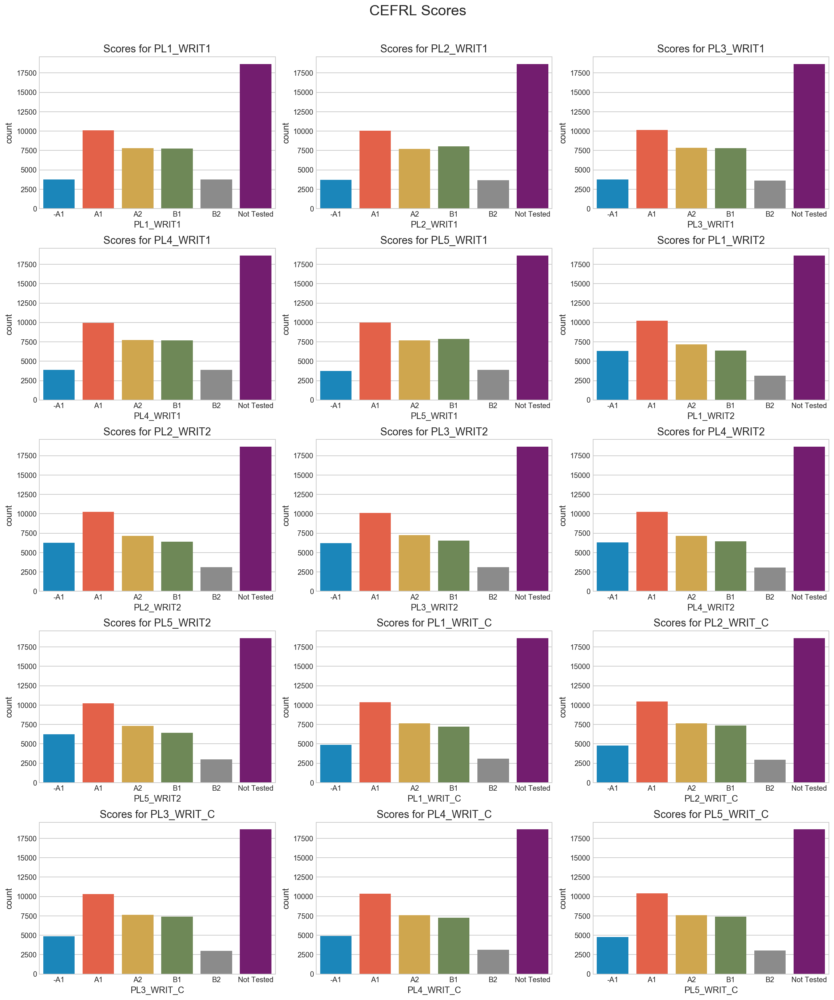

In [129]:
# plot writing scores
scores_fig(writing_cat)

DECISION
- The distribution of results across each class is close enough that I  believe I can get meaningful results by combining all columns for the same discipline into a single result per discipline. I will work on this basis for the categorical results and aim to have four targets in the categorical model: Listening, Reading, Writing and Combined.
- The 'Not Tested' values here indicate the students who were not tested on a particular discipline. I have considered imputing these values proportionally with the other result classes but as I am looking to predict these values with my model, I feel that making assumptions about the target values could undermine my predictions so instead, I will use data only for the students with actual test results for each discipline. 

## Single Result Target per Discipline

In [130]:
# function to populate one column with most common result for each discipline
def find_mode(row, discipline, overall=False):
    level_dict = {'-A1':0, 'A1':0, 'A2':0, 'B1':0, 'B2':0, 'Not Tested':0}
    for col in discipline:
        result = row[col]
        level_dict[result]+=1
    if overall:
        level_dict.pop('Not Tested')
    max_val = max(level_dict.values())
    tied = [key for key,val in level_dict.items() if val==max_val]
    mode = np.random.choice(tied)
    return mode

In [131]:
# populate new columns with most common result for each discipline
lang['PL_LIST'] = lang.apply(find_mode, discipline=listening, axis=1)
lang['PL_READ'] = lang.apply(find_mode, discipline=reading, axis=1)
lang['PL_WRIT'] = lang.apply(find_mode, discipline=writing, axis=1)
lang['PL_ALL'] = lang.apply(find_mode, discipline=combined, axis=1, overall=True)

In [132]:
# drop individual results columns as these will be strongly correlated with my target variables
lang.drop(listening, axis=1, inplace=True)
lang.drop(reading, axis=1, inplace=True)
lang.drop(writing, axis=1, inplace=True)

In [133]:
lang.shape

(51861, 368)

## Fill NaNs

The variety of data in the survey means that it doesn't make sense to impute all missing values as the mean for that feature. After reviewing the features I will need to impute in several stages as follows:
- to_mean: numerical values which are either not categorical or where the class directly relates to the value
- to_mode: categorical values where the class represents a particular grouping which should be respected and where 0 represents a specific class which shouldn't be assumed to be true overall
- to_zero: any feature where 0 means that something isn't done or doesn't apply and where it makes more sense to assume that the question would have been answered if the answer had been positive

In [134]:
# columns to impute as mean
to_mean = ['I01_ST_M_S39A','I01_ST_M_S40A','I01_ST_M_S40B',\
           'I01_ST_M_S44A','I01_ST_M_S44B','I01_ST_M_S59A',\
           'I02_ST_M_S37A','I02_ST_M_S37B','I02_ST_M_S41A',\
           'I03_ST_A_S04A','I03_ST_A_S25A','I03_ST_A_S26A',\
           'I03_ST_A_S28A','I03_ST_A_S29A','I03_ST_A_S30A',\
           'I03_ST_A_S31A','I03_ST_A_S45A','I05_ST_A_S23A',\
           'I05_ST_A_S24A','I05_ST_M_S62A','I06_ST_M_S45A',\
           'I06_ST_M_S46A','I08_ST_A_S02A','I08_ST_A_S19B',\
           'I09_IN_M_S49A','I09_IN_M_S50A','I09_IN_M_S51A',\
           'I09_IN_M_S57A','I09_ST_M_S33B','I09_ST_M_S48A',\
           'I09_ST_M_S52B','I14_IN_A_S42A','MPARED','FPARED',\
           'PARED','ISEI_M','ISEI_F','HISEI','SQt29i01',\
           'SQt41i01','SQt42i01','SQt42i01C','SQt43i01',\
          'SQt43i01C','SQt44i01','SQt44i01C','SQt44i02',\
          'SQt44i02C','SQt44i03','SQt44i03C']

In [135]:
# columns to impute as mode
to_mode = ['I01_ST_M_S39B','I02_ST_M_S38A','I03_ST_A_S03A',\
           'I08_ST_A_S01A','I14_ST_A_S06A','I14_ST_A_S06B',\
           'I14_ST_A_S06C','I14_ST_M_S47A','SQt27i01','SQt32i02',\
           'SQt32i03','SQt32i04','SQt38i01','SQt48i01','SQt48i02',\
           'SQt48i03','SQt48i04','SQt48i05','SQt48i06','SQt48i07',\
           'SQt52i01','SQt52i02','SQt52i03','SQt52i04','SQt52i05',\
          'SQt52i06','SQt52i07','SQt54i01','SQt54i02','SQt54i03',\
           'SQt54i04','SQt54i05','SQt54i06','SQt55i01','SQt55i02',\
           'SQt55i03','SQt55i04','SQt55i05','SQt55i06','SQt56i01',\
           'SQt56i02','SQt61i01','SQt61i02','SQt61i03','SQt61i04',\
           'SQt61i05','SQt61i06','SQt61i07']

In [136]:
# columns to impute as zero
to_zero = ['I01_ST_M_S63A','I01_ST_M_S63B','I03_ST_A_S04B',\
           'I03_ST_A_S25B','I03_ST_A_S26B','I03_ST_A_S27B',\
           'I04_ST_M_S64A','I04_ST_M_S64B','I08_ST_A_S15A',\
           'I08_ST_M_S64A','I08_ST_M_S64B']

In [137]:
# list of SQ survey columns
sq_cols = [col for col in lang.columns if 'SQ' in col]

# SQ columns where it makes more sense to impute as 0
sq_not_zero = ['SQt27i01','SQt29i01','SQt32i02','SQt32i03','SQt32i04',\
           'SQt38i01','SQt41i01','SQt42i01','SQt42i01C', 'SQt43i01',\
           'SQt43i01C','SQt44i01','SQt44i01C','SQt44i02','SQt44i02C',\
           'SQt44i03','SQt44i03C','SQt48i01','SQt48i02','SQt48i03',\
           'SQt48i04','SQt48i05','SQt48i06','SQt48i07','SQt52i01',\
           'SQt52i02','SQt52i03','SQt52i04','SQt52i05','SQt52i06',\
           'SQt52i07','SQt54i01','SQt54i02','SQt54i03','SQt54i04',\
           'SQt54i05','SQt54i06','SQt55i01','SQt55i02','SQt55i03',\
           'SQt55i04','SQt55i05','SQt55i06','SQt56i01','SQt56i02',\
           'SQt61i01','SQt61i02','SQt61i03','SQt61i04','SQt61i05',\
           'SQt61i06','SQt61i07']

In [138]:
# add the sq cols that should be imputed as zero to to_zero list
for col in sq_cols:
    if col not in sq_not_zero:
        to_zero.append(col) 

In [139]:
len(to_zero), len(to_mode), len(to_mean)

(254, 48, 50)

In [140]:
# subset to columns to impute as mode/mean
mean_subset = lang.loc[:,to_mean]
mode_subset = lang.loc[:,to_mode]

In [141]:
# impute columns with mode
imp_mode = Imputer(strategy='most_frequent')
lang_mode = imp_mode.fit_transform(mode_subset)
lang_mode = pd.DataFrame(lang_mode, columns=mode_subset.columns)

In [142]:
# impute columns with mean
imp_mean = Imputer(strategy='mean')
lang_mean = imp_mean.fit_transform(mean_subset)
lang_mean = pd.DataFrame(lang_mean, columns=mean_subset.columns)

In [143]:
lang_mean.shape, lang_mode.shape

((51861, 50), (51861, 48))

In [144]:
# merge mean and mode dfs
lang2 = lang_mode.merge(lang_mean, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [145]:
# set list of remaining columns
remaining_cols = [col for col in lang.columns if col not in to_mean and col not in to_mode]

In [146]:
# check that no columns have been missed
len(lang.columns) - (len(remaining_cols) + len(lang2.columns))

0

In [147]:
# subset to the remaining columns
lang3 = lang.loc[:,remaining_cols]

In [148]:
# merge subsets back into a single df
lang = lang3.merge(lang2, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [149]:
lang.shape

(51861, 368)

In [150]:
# fill remaining NaN's with zeros
lang.fillna(0., inplace=True)

## Binarise target variables

The results are divided into 5 levels from -A1 to B2, with B2 being the highest. According to the Common European Framework of Reference for Languages against which these tests have been scored, B represents an 'Independent User' and A represents a 'Basic User'. As the aim of my project is to predict high performance in a language, I will binarise the target with levels B1 and B2 representing 'high performance'.  

In [151]:
# create binarised result columns
lang['Target_Listening'] = lang['PL_LIST'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_Reading'] = lang['PL_READ'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_Writing'] = lang['PL_WRIT'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)
lang['Target_All'] = lang['PL_ALL'].map(lambda x: 1 if x == 'B1' or x == 'B2' else 0)

In [152]:
# save target variable columns as list
targets_cat = ['PL_LIST','PL_READ','PL_WRIT','PL_ALL']
targets_bin = ['Target_Listening','Target_Reading','Target_Writing','Target_All']

In [153]:
# save categorical result columns for future multiclass modelling and drop from main df
multiclass = lang.loc[:,targets_cat]
lang.drop(targets_cat, axis=1, inplace=True)

In [154]:
# set path to save csv
path='/Users/lizspiking/DataScience/language-competence/'

# save df to csv
lang.to_csv(path + 'lang_0406.csv', sep=',', na_rep='', float_format=None,\
                 header=True, index=False, mode='w', encoding='UTF-8',\
                 compression=None, quoting=None, quotechar='"',\
                 line_terminator='\n', decimal='.')

## Extend Column Headers

Most of the columns in the dataset have coded headers which make it very difficult to understand what the column represents. I will append more descriptive text to the column headers to make the data easier to understand.

In [155]:
columns_expanded = ['','','','','','gender','home_location','first_language1',\
                    'first_language_target','first_lang_non_indig1',\
                    'first_lang_non_indig2','first_lang_non_indig4',\
                    'first_lang_other_euro1','first_lang_other_euro2',\
                    'grade','grade_clean','study_prog','empl_status_mother',\
                    'empl_status_father','mother_highest_school_level',\
                    'father_highest_school_level','birth_country',\
                    'birth_country_mother','birth_country_father',\
                    'years_in_country','desk_at_home','own_room',\
                    'quiet_place_to_study','books_to_help','computer',\
                    'educational_software','internet','dictionary',\
                    'classic_literature','poetry_books','art_works',\
                    'dishwasher','dvd_player','country_specific_item1',\
                    'country_specific_item2','country_specific_item3',\
                    'no_of_books','no_of_mobiles','no_of_tvs',\
                    'no_of_computers','no_of_cars','no_of_bathrooms',\
                    'own_computer','internet_access','printer',\
                    'cd_dvd_writer','scanner','usb_stick','games_console',\
                    'own_mp3_player','own_mobile','freq_computer_use_homework',\
                    'freq_computer_use_lang','freq_computer_use_info',\
                    'freq_computer_use_games','freq_computer_use_entertainment',\
                    'freq_computer_use_contact','lang_home1','lang_home_target',\
                    'lang_home_non_indig1','lang_home_non_indig2',\
                    'lang_home_non_indig4','lang_home_other_euro',\
                    'lang_home_other_non_euro','lang_used_at_home_indig1',\
                    'lang_used_at_home_target','lang_used_at_home_non_indig1',\
                    'lang_used_at_home_non_indig2',\
                    'lang_used_at_home_non_indig4',\
                    'lang_used_at_home_other_euro',\
                    'lang_used_at_home_non_euro','target_lang_level_father',\
                    'target_lang_level_mother',\
                    'target_lang_relatives_in_country',\
                    'target_lang_friends_in_country',\
                    'target_lang_tourist_home_country',\
                    'target_lang_people_in_residence','target_lang_internet',\
                    'target_lang_holidays','target_lang_write_friends_freq',\
                    'target_lang_speak_relatives_freq',\
                    'target_lang_speak_friends_freq',\
                    'target_language_speak_residence_freq',\
                    'target_lang_speak_tourists_freq',\
                    'target_lang_speak_internet_freq','target_lang_songs_freq',\
                    'target_lang_movies_no_subtitles_freq',\
                    'target_lang_movies_subtitles_freq',\
                    'target_lang_tv_no_subtitles_freq',\
                    'target_lang_tv_subtitles_freq','target_lang_games_freq',\
                    'target_lang_books_freq','target_lang_mag_comic_freq',\
                    'target_lang_website_freq',\
                    'perceived_competence_people_country',\
                    'target_lang_usefulness_travel',\
                    'target_lang_usefulness_personal_life',\
                    'target_lang_usefulness_education',\
                    'target_lang_usefulness_work',\
                    'target_lang_usefulness_getting_job',\
                    'target_lang_usefulness_contact_foreigners',\
                    'target_lang_usefulness_satisfaction',\
                    'target_lang_usefulness_computers',\
                    'target_lang_usefulness_reading',\
                    'target_lang_usefulness_entertainment','enjoyment_maths',\
                    'enjoyment_science','enjoyment_humanities',\
                    'enjoyment_arts','enjoyment_questionnaire_lang',\
                    'enjoyment_target_lang','enjoyment_other_langs',\
                    'enjoyment_vocational_subjects','enjoyment_sports',\
                    'usefulness_maths','usefulness_science',\
                    'usefulness_humanities','usefulness_arts',\
                    'usefulness_questionnaire_lang','usefulness_target_lang',\
                    'usefulness_other_langs','usefulness_vocational_subjects',\
                    'usefulness_sports','hw_time_maths','hw_time_science',\
                    'hw_time_humanities','hw_time_arts',\
                    'hw_time_questionnaire_lang','hw_time_target_lang',\
                    'hw_time_other_langs','hw_time_vocational_subjects',\
                    'hw_time_sports','first_widely_taught_lang_in_country',\
                    'second_widely_taught_lang_in_country',\
                    'third_widely_taught_lang_in_country',\
                    'fourth_widely_taught_lang_in_country',\
                    'fifth_widely_taught_lang_in_country','other_lang',\
                    'lang_taught_3rd_ISCED2','lang_taught_2nd_ISCED2',\
                    'lang_taught_1st_ISCED2','lang_taught_6th_ISCED1',\
                    'lang_taught_5th_ISCED1','lang_taught_4th_ISCED1',\
                    'lang_taught_3rd_ISCED1','lang_taught_2nd_ISCED1',\
                    'lang_taught_1st_ISCED1','lang_taught_pre_1st_ISCED1',\
                    'target_lang_taught_3rd_ISCED2',\
                    'target_lang_taught_2nd_ISCED2',\
                    'target_lang_taught_1st_ISCED2',\
                    'target_lang_taught_6th_ISCED1',\
                    'target_lang_taught_5th_ISCED1',\
                    'target_lang_taught_4th_ISCED1',\
                    'target_lang_taught_3rd_ISCED1',\
                    'target_lang_taught_2nd_ISCED1',\
                    'target_lang_taught_1st_ISCED1',\
                    'target_lang_taught_pre_1st_ISCED1',\
                    'freq_school_trips_target_lang_country',\
                    'freq_school_trips_non_target_lang_country',\
                    'freq_trips_family_target_lang_country',\
                    'freq_trips_family_non_target_lang_country',\
                    'freq_visits_from_school_class_target_lang',\
                    'freq_visits_from_school_class_non_target_lang',\
                    'freq_collab_schools_abroad','freq_lang_clubs',\
                    'freq_lang_competitions','freq_european_day_of_langs',\
                    'freq_extracurricular_lang_projects',\
                    'freq_writing_students_abroad','freq_lang_field_trips',\
                    'compulsory_target_lang_learning',\
                    'freq_teacher_speaks_target_lang_whole_class',\
                    'freq_teacher_speaks_target_lang_few_students',\
                    'freq_students_speak_target_lang_to_teacher',\
                    'freq_students_speak_target_lang_group_work',\
                    'freq_students_speak_target_lang_before_whole_c',\
                    'freq_target_lang_audio_materials_in_class',\
                    'freq_target_lang_video_in_class',\
                    'freq_target_lang_text_in_class',\
                    'freq_target_lang_internet_in_class',\
                    'freq_target_lang_computer_programmes_in_class',\
                    'freq_target_lang_pc_labs',\
                    'freq_target_lang_textbooks',\
                    'freq_target_lang_books_fiction',\
                    'freq_target_lang_lesson_materials',\
                    'freq_group_work_target_lang',\
                    'freq_indiv_work_target_lang',\
                    'freq_group_students_speak_before_class_target_',\
                    'freq_indiv_student_speaks_before_class_target_',\
                    'freq_teacher_speaks_to_whole_class_target_lang',\
                    'freq_teacher_speaks_to_few_students_target_lan',\
                    'freq_emphasis_between_target_and_other_lang_wr',\
                    'freq_emphasis_between_target_and_other_lang_sp',\
                    'freq_emphasis_between_target_and_other_lang_un',\
                    'freq_emphasis_between_target_and_other_lang_gr',\
                    'freq_emphasis_between_target_and_other_lang_re',\
                    'freq_emphasis_between_target_and_other_lang_pr',\
                    'freq_emphasis_between_target_and_other_lang_vocab',\
                    'freq_learning_writing_target_lang',\
                    'freq_learning_speaking_target_lang',\
                    'freq_learning_understanding_spoken_target_lang',\
                    'freq_learning_grammar_target_lang',\
                    'freq_learning_reading_target_lang',\
                    'freq_learning_pronunciation_target_lang',\
                    'freq_learning_vocab_target_lang',\
                    'freq_test_target_lang','freq_feedback_on_assignments',\
                    'time_spent_studying_for_tests',\
                    'freq_computer_use_target_lang_info_finding',\
                    'freq_computer_use_target_lang_homework',\
                    'freq_computer_use_target_lang_writing',\
                    'freq_computer_use_target_lang_speaking',\
                    'freq_computer_use_target_lang_understanding_sp',\
                    'freq_computer_use_target_lang_grammar',\
                    'freq_computer_use_target_lang_reading',\
                    'freq_computer_use_target_lang_pronunciation',\
                    'freq_computer_use_target_lang_vocab',\
                    'time_spent_homework_target_lang',\
                    'time_spent_homework_other_langs',\
                    'enrichment_lessons_target_lang',\
                    'enrichment_lessons_other_langs',\
                    'remedial_lessons_target_lang',\
                    'remedial_lessons_other_langs',\
                    'extra_lessons_questionnaire_lang',\
                    'extra_lessons_not_questionnaire_lang_spoken_at',\
                    'target_lang_can_understand_familiar_words_simp',\
                    'target_lang_can_find_info_ads_timetables_reading',\
                    'target_lang_can_find_main_points_simple_news_a',\
                    'target_lang_can_read_long_complex_texts_locati',\
                    'target_lang_can_understand_qs_instructions_if_',\
                    'target_lang_can_understand_if_spoken_slowly_cl',\
                    'target_lang_can_understand_radio_TV_programmes',\
                    'target_lang_can_understand_long_complicated_le',\
                    'target_lang_can_write_few_words_phrases_relati',\
                    'target_lang_can_write_basic_description_of_events',\
                    'target_lang_can_write_detailed_letters_relatin',\
                    'target_lang_can_write_detailed_review_film_boo',\
                    'target_lang_can_ask_answer_simple_questions_fa',\
                    'target_lang_can_tell_simple_story',\
                    'target_lang_can_maintain_conversation_familiar',\
                    'target_lang_can_explain_viewpoint_advantages_d',\
                    'occupation_mother','occupation_father',\
                    'home_possessions','target_lang_learning_time_homework',\
                    'foreign_lang_learning_time_homework',\
                    'target_lang_first_lang','target_lang_exposure_home',\
                    'target_lang_used_home',\
                    'target_lang_most_spoken_lang_home',\
                    'target_lang_enrichment_remedial_lessons',\
                    'foreign_lang_enrichment_remedial_lessons',\
                    'immigration_background',\
                    'received_help_mastering_host_lang',\
                    'received_formal_education_lang_of_origin','','','','',\
                    '','onset_FL_education','first_lang_studied_school',\
                    'home_location','gender','programme_level',\
                    'program_designation','programme_orientation_clean',\
                    'compulsory_target_lang_learning','home_lang_most_used',\
                    'perceived_competence_father',\
                    'perceived_competence_mother',\
                    'perceived_competence_self',\
                    'first_foreign_lang_learnt_school',\
                    'perceived_difficulty_target_lang_writing',\
                    'perceived_difficulty_target_lang_speaking',\
                    'perceived_difficulty_target_lang_understanding',\
                    'perceived_difficulty_target_lang_grammar',\
                    'perceived_difficulty_target_lang_reading',\
                    'perceived_difficulty_target_lang_pronunciation',\
                    'perceived_difficulty_target_lang_vocab',\
                    'perceived_usefulness_for_writing_target_lang_t',\
                    'perceived_usefulness_for_speaking_target_lang_',\
                    'perceived_usefulness_for_understanding_target_',\
                    'perceived_usefulness_for_grammar_target_lang_t',\
                    'perceived_usefulness_for_reading_target_lang_t',\
                    'perceived_usefulness_for_pronunciation_target_',\
                    'perceived_usefulness_for_vocab_target_lang_tex',\
                    'perception_target_lang_teacher_is_good',\
                    'perception_target_lang_teacher_get_along',\
                    'perception_target_lang_teacher_makes_effort_in',\
                    'perception_target_lang_teacher_helpful',\
                    'perception_target_lang_teacher_like',\
                    'perception_target_lang_teacher_strict',\
                    'perception_target_lang_lessons_interesting',\
                    'perception_target_lang_lessons_enjoyable',\
                    'perception_target_lang_lessons_good',\
                    'perception_target_lang_lessons_waste_of_time',\
                    'perception_target_lang_lessons_easy',\
                    'perception_target_lang_lessons_boring',\
                    'perceived_difficulty_learning_target_lang_usua',\
                    'perceived_difficulty_learning_target_lang_stud',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'perceived_importance_for_target_lang_final_gra',\
                    'duration_FL_education','duration_TL_education',\
                    'onset_TL_education','target_lang_lesson_time_week',\
                    'foreign_lang_lesson_time_week',\
                    'target_lang_learning_time_tests',\
                    'no_ancient_foreign_langs_learnt',\
                    'no_modern_foreign_langs_learnt',\
                    'no_langs_studied_before_target_lang',\
                    'no_first_languages','no_langs_at_home_exposure',\
                    'no_langs_at_home_use',\
                    'target_lang_parents_knowledge',\
                    'target_lang_exposure_through_home_env',\
                    'target_lang_use_through_home_env',\
                    'target_lang_exposure_use_through_media',\
                    'target_lang_exposure_use_visits_abroad',\
                    'ICT_facilities_at_home','freq_ICT_use_outside_school',\
                    'freq_ICT_use_lang_learning',\
                    'received_opportunities_target_lang_exchange_vi',\
                    'received_opportunities_target_lang_school_proj','age',\
                    'economic_social_cultural_status',\
                    'teachers_use_target_lang_during_foreign_lang_l',\
                    'students_use_target_lang_during_foreign_lang_l',\
                    'resource_use_target_lang_lessons',\
                    'perceived_emphasis_similarities_between_known_',\
                    'indicator_for_perception_usefulness_target_lan',\
                    'perceived_difficulty_target_lang_learning',\
                    'indicator_perception_target_lang_lessons_teach',\
                    'class_size','mother_education_years',\
                    'father_education_years',\
                    'highest_parental_education_years',\
                    'socio_economic_index_occupation_mother',\
                    'socio_economic_index_occupation_father',\
                    'highest_occupational_status',\
                    'target_lang_exposure_penfriend',\
                    'no_langs_studied_pre_target_lang','class_size',\
                    'class_size_clean','class_duration',\
                    'class_duration_clean','target_lang_classes_per_week',\
                    'target_lang_classes_per_week_clean',\
                    'lang_classes_per_week','lang_classes_per_week_clean',\
                    'total_classes_per_week','total_classes_per_week_clean',\
                    '','','','']

In [156]:
# compare number of columns in df against columns_expanded
len(columns_expanded), len(lang.columns)

(368, 368)

In [157]:
# update df column names to include expanded description for clarity
lang.columns = [col + '_' + expanded for col,expanded\
                in zip(lang.columns,columns_expanded)]

In [158]:
# clean trailing underscores from column headers
lang.columns = lang.columns.str.rstrip('_')

## ICT (Information and Communications Technology)

In [159]:
# group ICT-related features together
ict = [col for col in lang.columns if 'ICT' in col or 'computer' in col]

In [180]:
from matplotlib.ticker import FormatStrFormatter
# function to plot response data for multiple features
def features_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,36))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(10,3,j)
        #plt.title('Responses for \n' + str(i), fontsize=15)
        sns.countplot(x=i, data=data)
        #plt.ticklabel_format(FormatStrFormatter('%.2f'))
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [188]:
# save ict data
ict_df = lang.loc[:,ict]

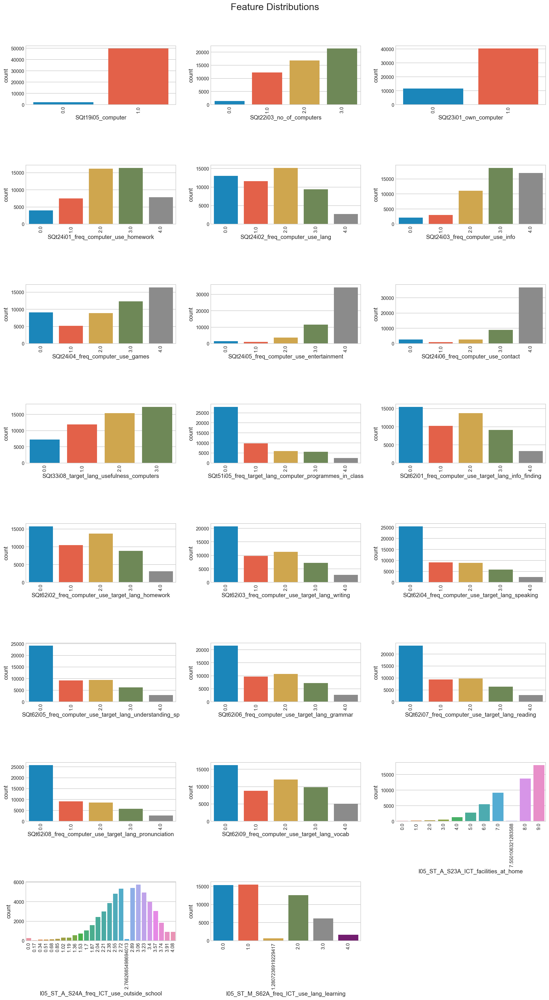

In [182]:
features_fig(ict_df)

In [189]:
# set targets df to merge with feature-specific DFs for correlation matrices
targets_df = lang.loc[:,targets_bin].copy()

In [190]:
# merge targets into feature-specific DF
ict_df = ict_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [191]:
# create correlation matrix
ict_corr = ict_df.corr()

In [208]:
# heatmap function to compare correlations
def heatmap_func(data):
    fig,ax = plt.subplots(figsize=(25,25))
    sns.set(font_scale=1.2)
    sns.set_style("whitegrid")

    mask = np.zeros_like(data, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    ax = sns.heatmap(data, ax=ax, cmap='coolwarm', center=0, annot=True, mask=mask)
    ax.tick_params(labelsize=16);

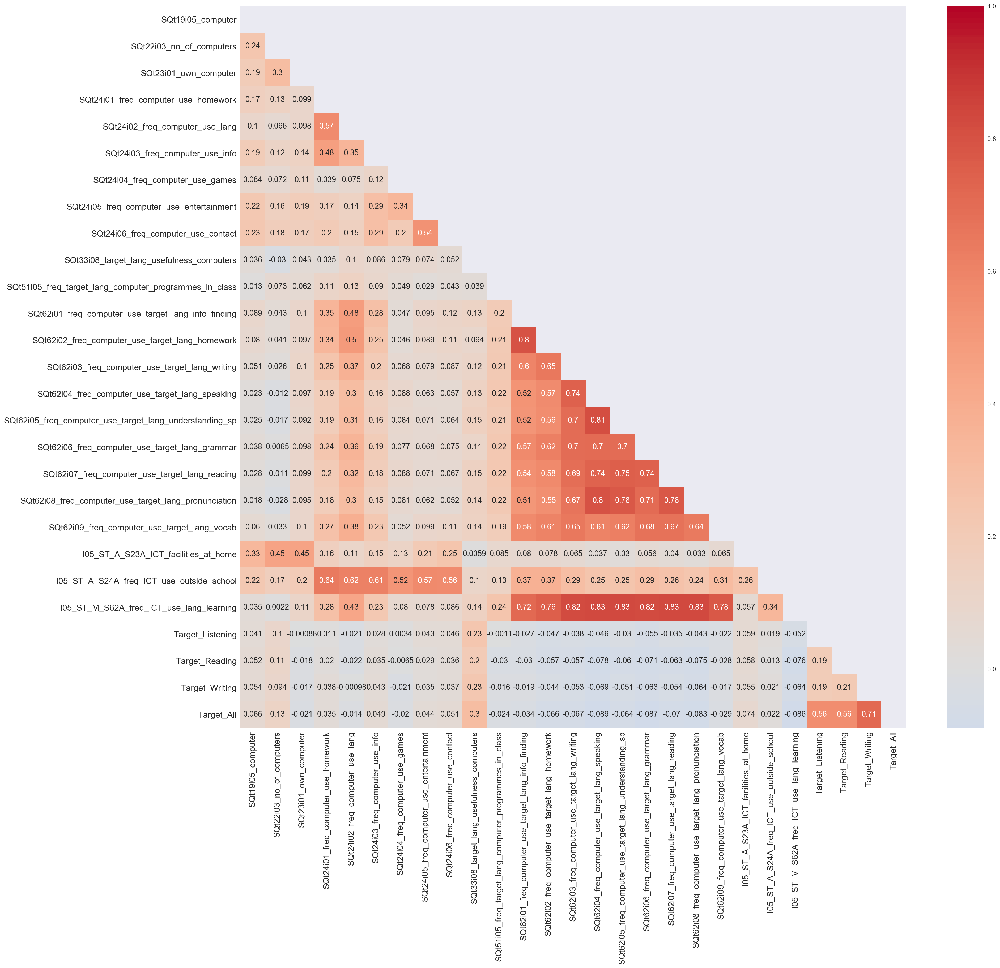

In [209]:
# display ICT heatmap
heatmap_func(ict_corr)

## Time Spent Studying

In [202]:
# group time spent studying-related features together
study = [col for col in lang.columns if 'hw_time' in col\
         or 'time_spent' in col]

In [211]:
# save study data
study_df = lang.loc[:,study]

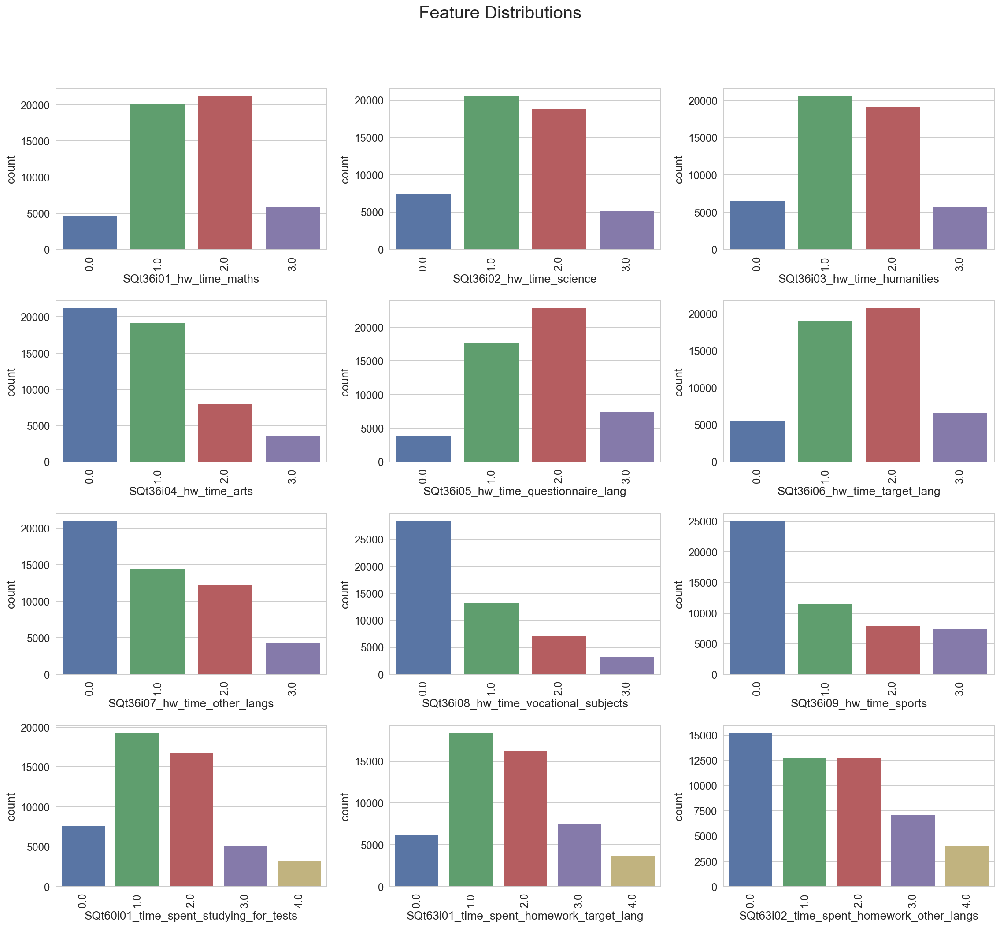

In [212]:
# plot study data
features_fig(study_df)

In [213]:
# merge study and target data for correlations
study_df = study_df.merge(targets_df, how='left', left_index=True, right_index=True,suffixes=('', ''))

In [214]:
# create correlation matrix
study_corr = study_df.corr()

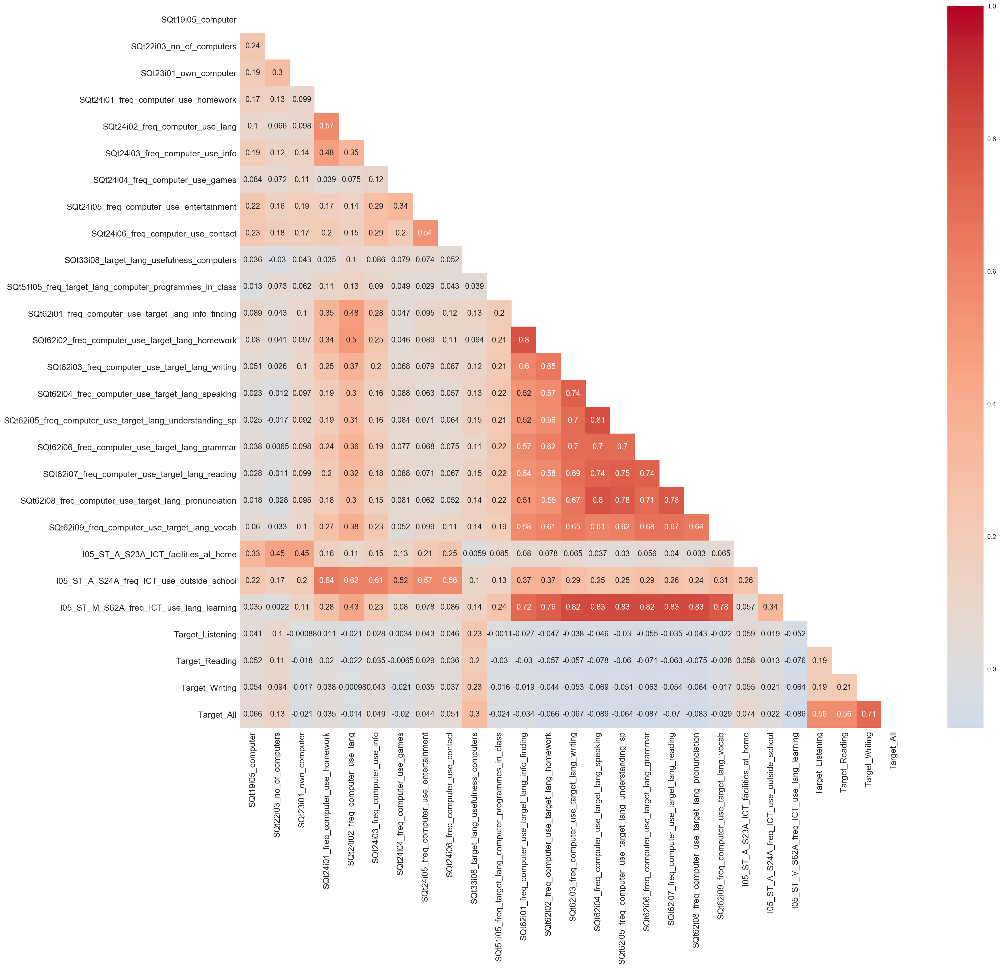

In [215]:
heatmap_func(ict_corr)

## Target Language-Specific Features

In [224]:
# group target language-related features together
TL_list = [col for col in lang.columns if 'TL' in col\
           or 'target_language' in col or 'target_lang' in col]

In [231]:
# function to plot response data for multiple features
def many_features_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,120))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(60,3,j)
        #plt.title('Responses for \n' + str(i), fontsize=15)
        sns.countplot(x=i, data=data)
        #plt.ticklabel_format(FormatStrFormatter('%.2f'))
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [223]:
len(TL_list)

165

In [227]:
# save target language data
TL_df = lang.loc[:,TL_list]

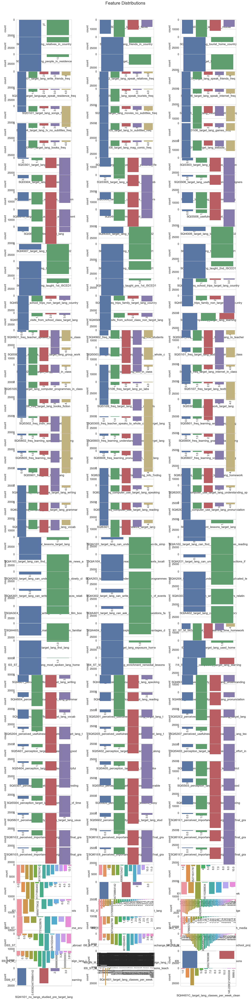

In [230]:
# plot target language data
many_features_fig(TL_df)

In [232]:
# merge target language and Targets for correlation
TL_df = TL_df.merge(targets_df, how='left', left_index=True,\
                    right_index=True,suffixes=('', ''))

In [233]:
# create target language correlation matrix
TL_corr = TL_df.corr()

In [234]:
#heatmap_func(TL_corr)

#### Action
These charts and the ones below take ages to run/need reformatting so I am leaving them out of the submission just because I'm already so behind! I will sort out proper charts before publishing.

## Foreign Language-Specific Features

In [235]:
# group foreign language-related features together
FL_list = [col for col in lang.columns if 'FL' in col\
           or 'foreign_language' in col or 'foreign_lang' in col]

In [236]:
# save foreign language data
FL_df = lang.loc[:,FL_list]

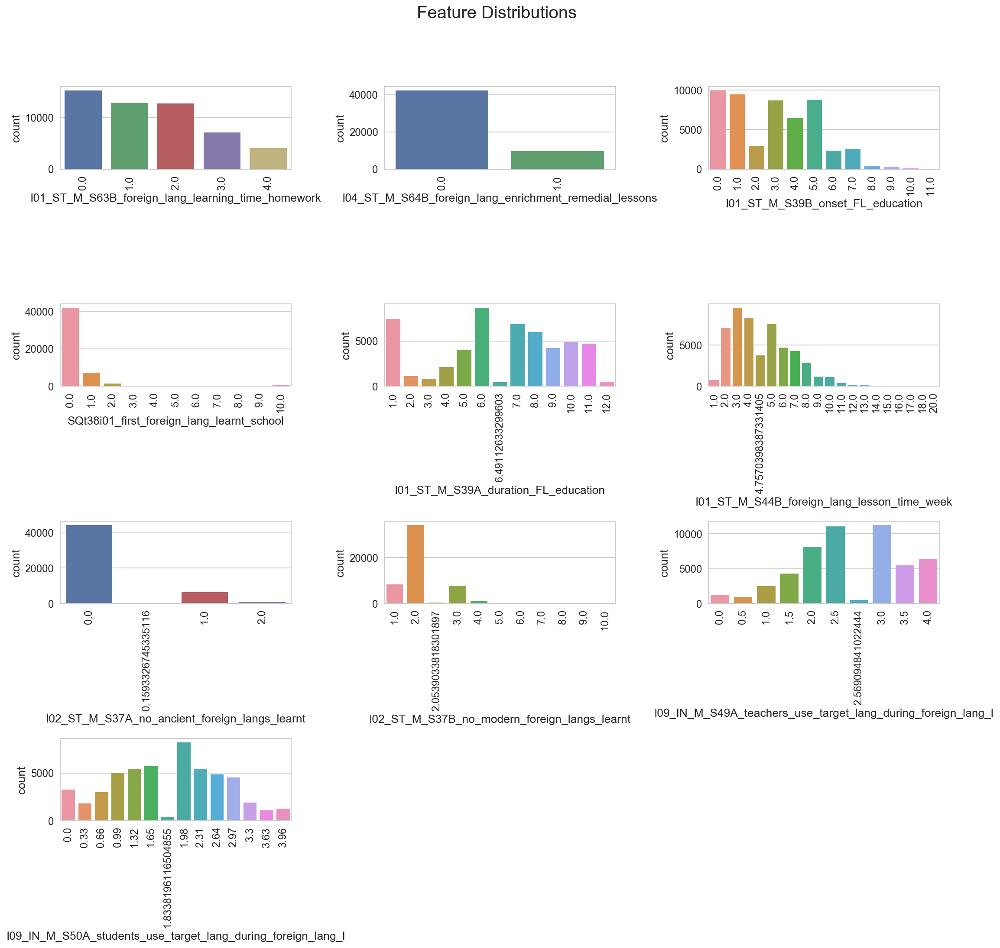

In [238]:
# plot foreign language data
features_fig(FL_df)

In [239]:
# merge foreign language and target data for correlations
FL_df = FL_df.merge(targets_df, how='left', left_index=True,\
                    right_index=True,suffixes=('', ''))

In [240]:
# create foreign language correlation matrix
FL_corr = FL_df.corr()

In [254]:
# heatmap function to compare correlations on fewer features
def small_heatmap_func(data):
    fig,ax = plt.subplots(figsize=(8,8))
    sns.set(font_scale=0.8)
    sns.set_style("whitegrid")

    mask = np.zeros_like(data, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    ax = sns.heatmap(data, ax=ax, cmap='coolwarm', center=0, annot=True, mask=mask)
    ax.tick_params(labelsize=10);

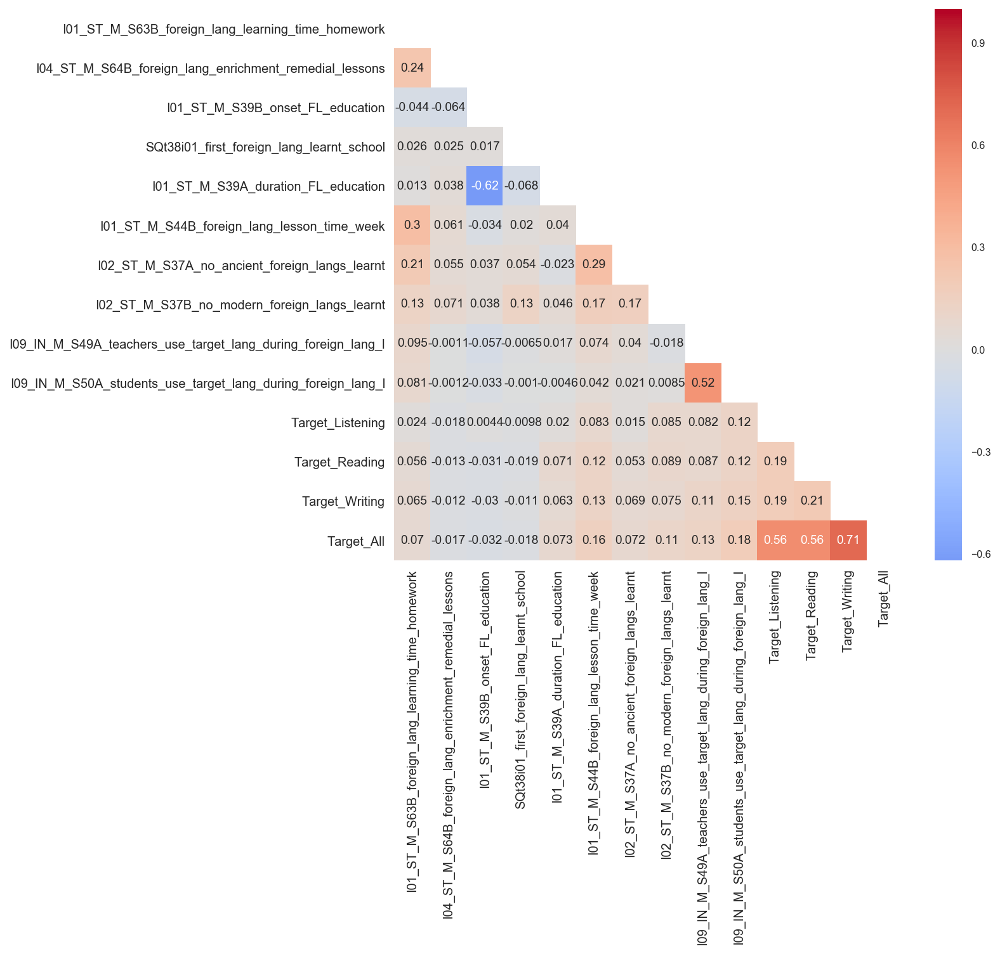

In [255]:
# plot foreign language heatmap
small_heatmap_func(FL_corr)

## Enjoyment

In [256]:
# group enjoyment-related features together
enjoyment = [col for col in lang.columns if 'enjoyment' in col]

In [257]:
# save enjoyment data
enjoyment_df = lang.loc[:,enjoyment]

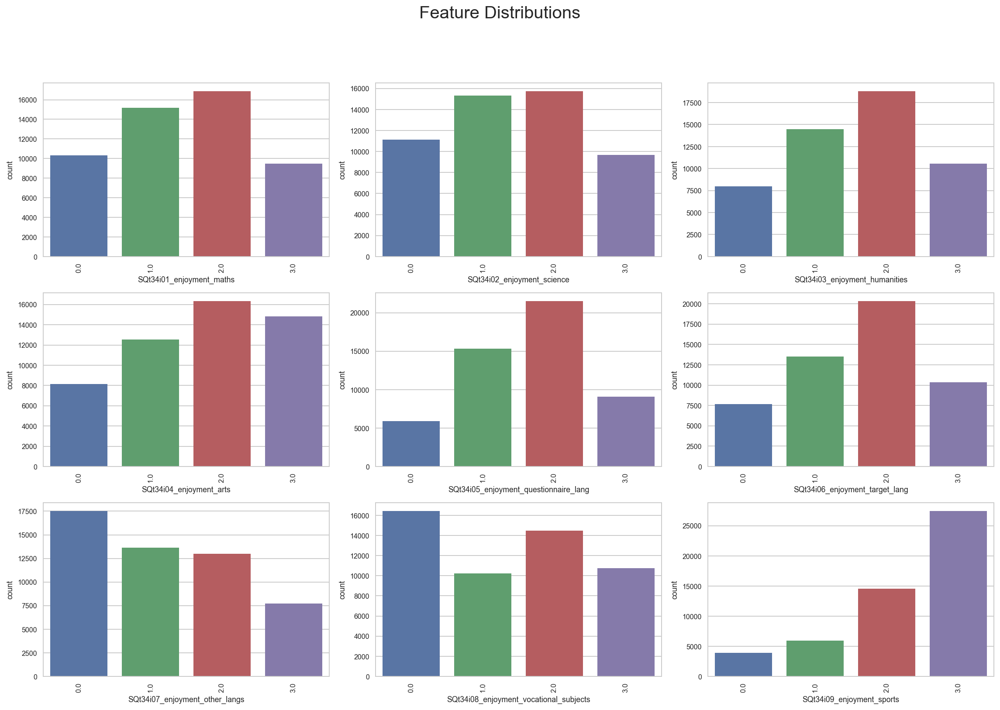

In [258]:
# plot enjoyment data
features_fig(enjoyment_df)

In [259]:
# merge enjoyment and target data for correlations
enjoyment_df = enjoyment_df.merge(targets_df, how='left', left_index=True,\
                                  right_index=True,suffixes=('', ''))

In [260]:
# create enjoyment correlation matrix
enjoyment_corr = enjoyment_df.corr()

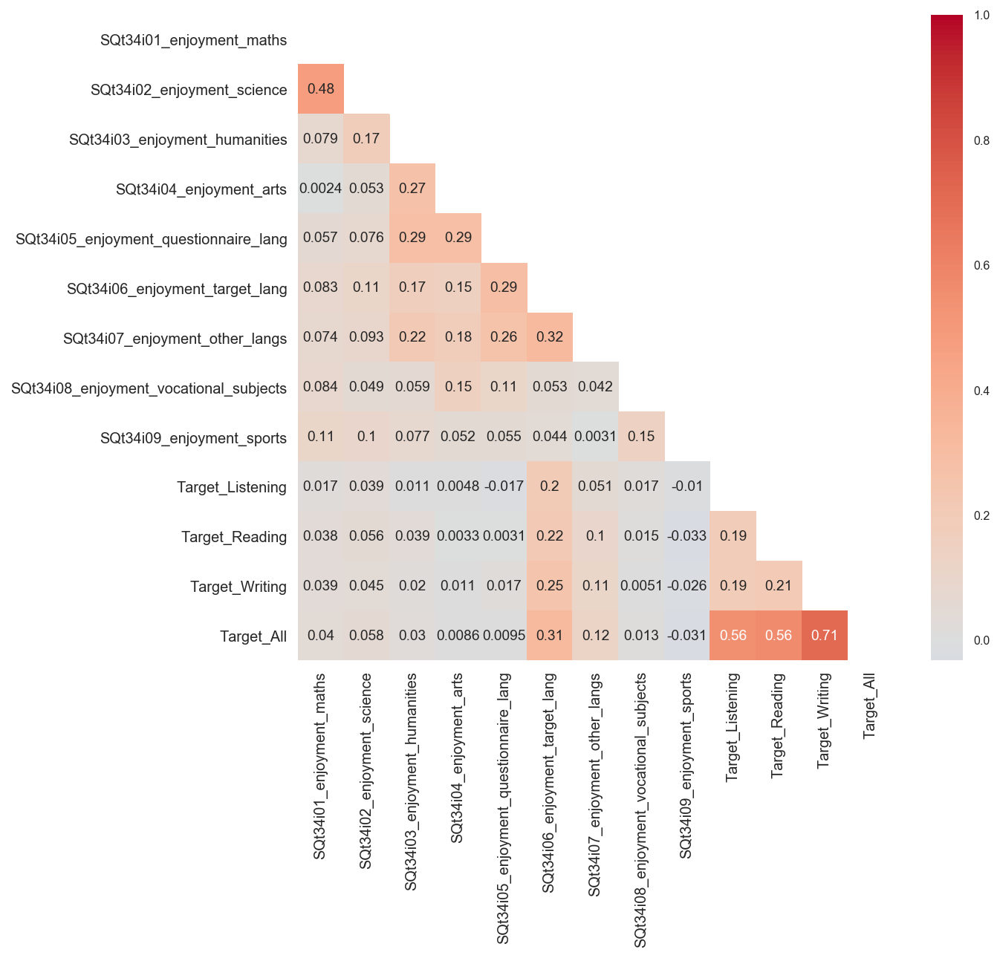

In [261]:
# plot enjoyment heatmap
small_heatmap_func(enjoyment_corr)

## Perceived Difficulty

In [264]:
# group difficulty-related features together
difficulty = [col for col in lang.columns if 'difficulty' in col]
len(difficulty)

10

In [265]:
# save difficulty data
difficulty_df = lang.loc[:,difficulty]

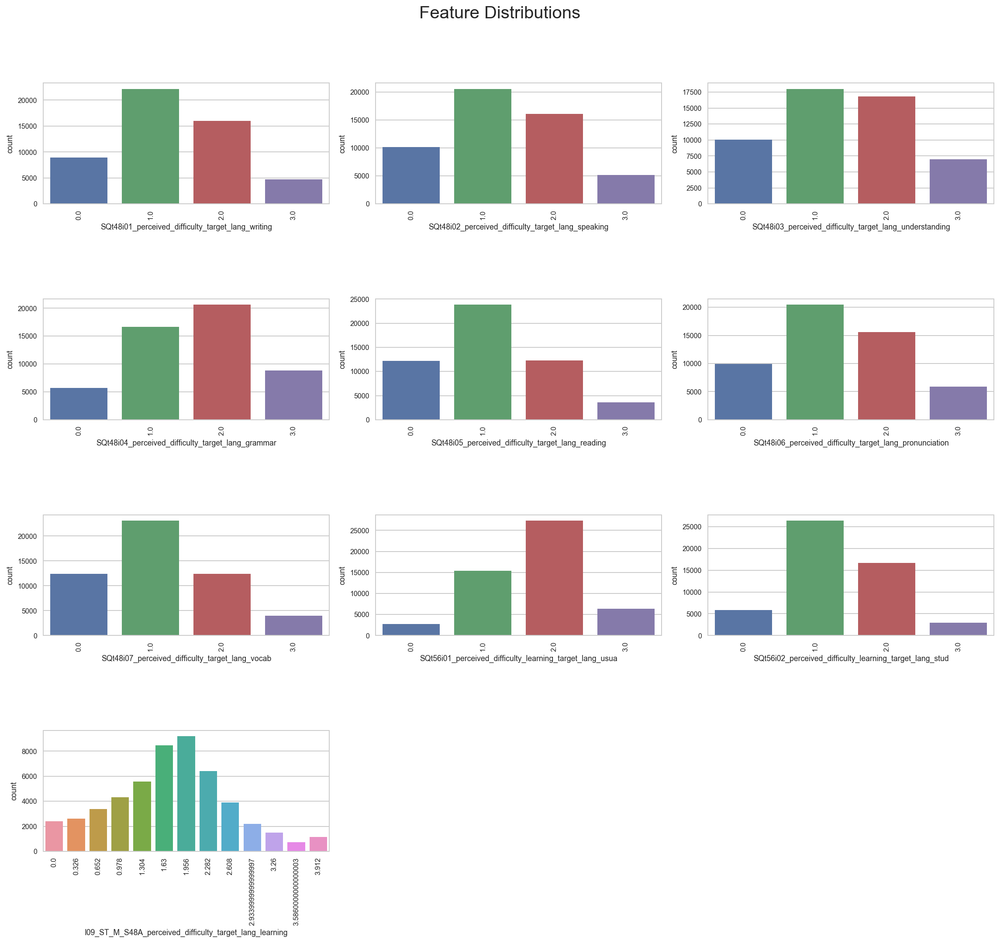

In [266]:
# plot difficulty data
features_fig(difficulty_df)

#### Action
I need to amend the figsize for these charts and sort out the tick labels for the last feature.

In [267]:
# merge difficulty and target data for correlations
difficulty_df = difficulty_df.merge(targets_df, how='left', left_index=True,\
                                    right_index=True,suffixes=('', ''))

In [268]:
# create difficulty correlation matrix
difficulty_corr = difficulty_df.corr()

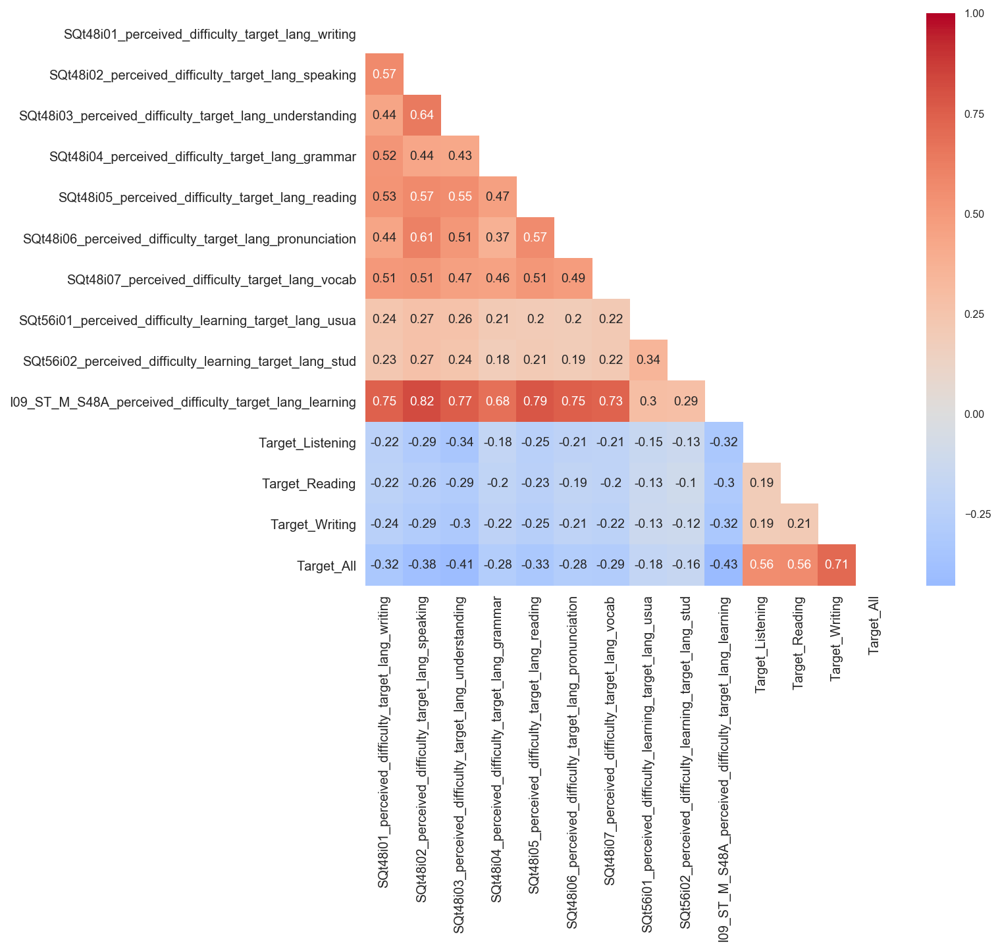

In [269]:
# plot difficulty heatmap
small_heatmap_func(difficulty_corr)

## Perceived Importance

In [270]:
# group perceived importance-related features together
importance = [col for col in lang.columns if 'importance' in col]

In [271]:
# save importance data
importance_df = lang.loc[:,importance]

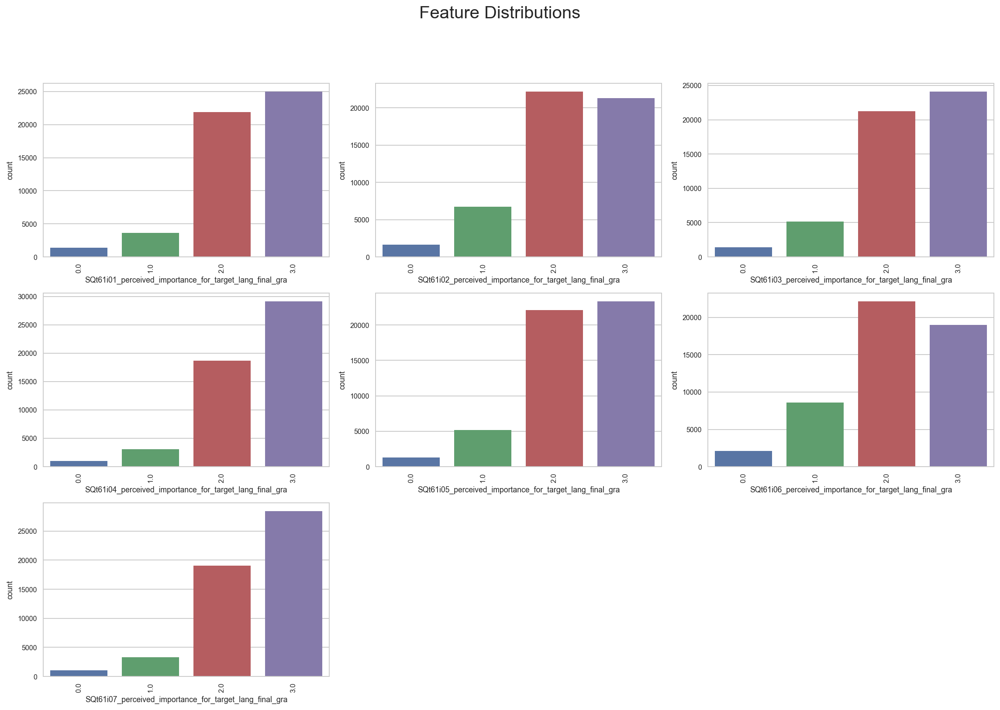

In [272]:
# plot importance data
features_fig(importance_df)

In [273]:
# marge difficulty and target data for correlations
importance_df = importance_df.merge(targets_df, how='left', left_index=True,\
                                    right_index=True,suffixes=('', ''))

In [274]:
# create importance correlation matrix
importance_corr = importance_df.corr()

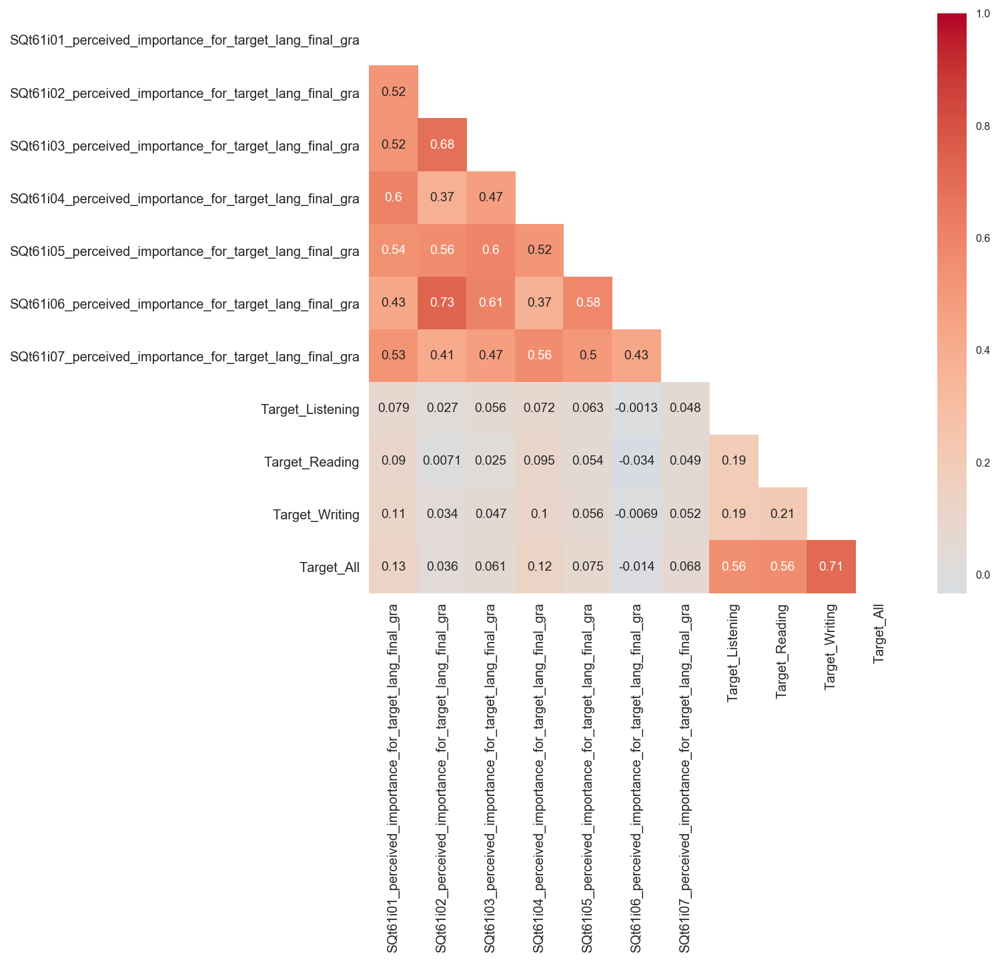

In [275]:
# plot importance heatmap
small_heatmap_func(importance_corr)

## Onset of Language Teaching

In [276]:
# group features related to the onset of language teaching together
onset = [col for col in lang.columns if 'lang_taught' in col\
         or 'language_taught' in col or 'onset' in col]

In [277]:
# save inset data
onset_df = lang.loc[:,onset]

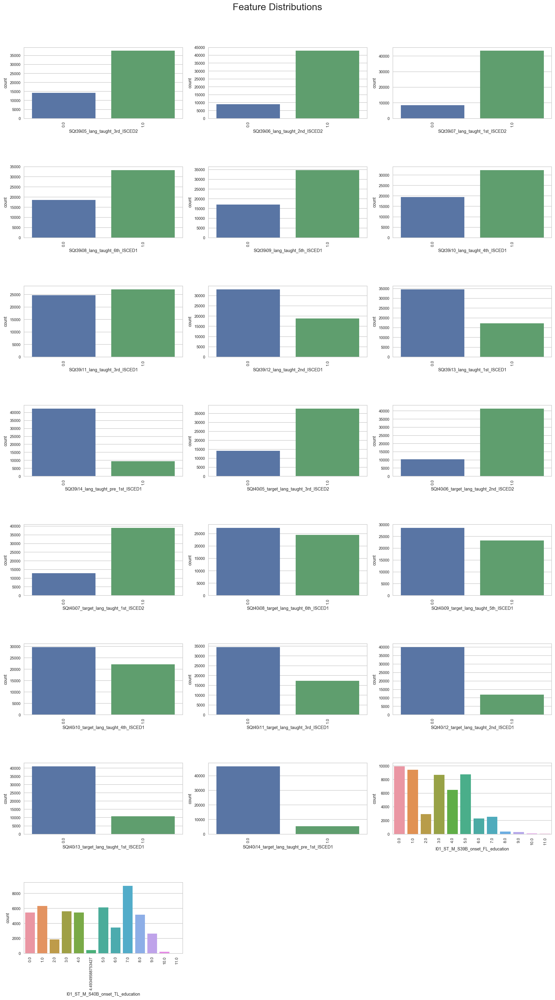

In [278]:
# plot onset data
features_fig(onset_df)

In [279]:
# merge onset and target data for correlations
onset_df = onset_df.merge(targets_df, how='left', left_index=True,\
                          right_index=True,suffixes=('', ''))

In [280]:
# create onset correlation matrix
onset_corr = onset_df.corr()

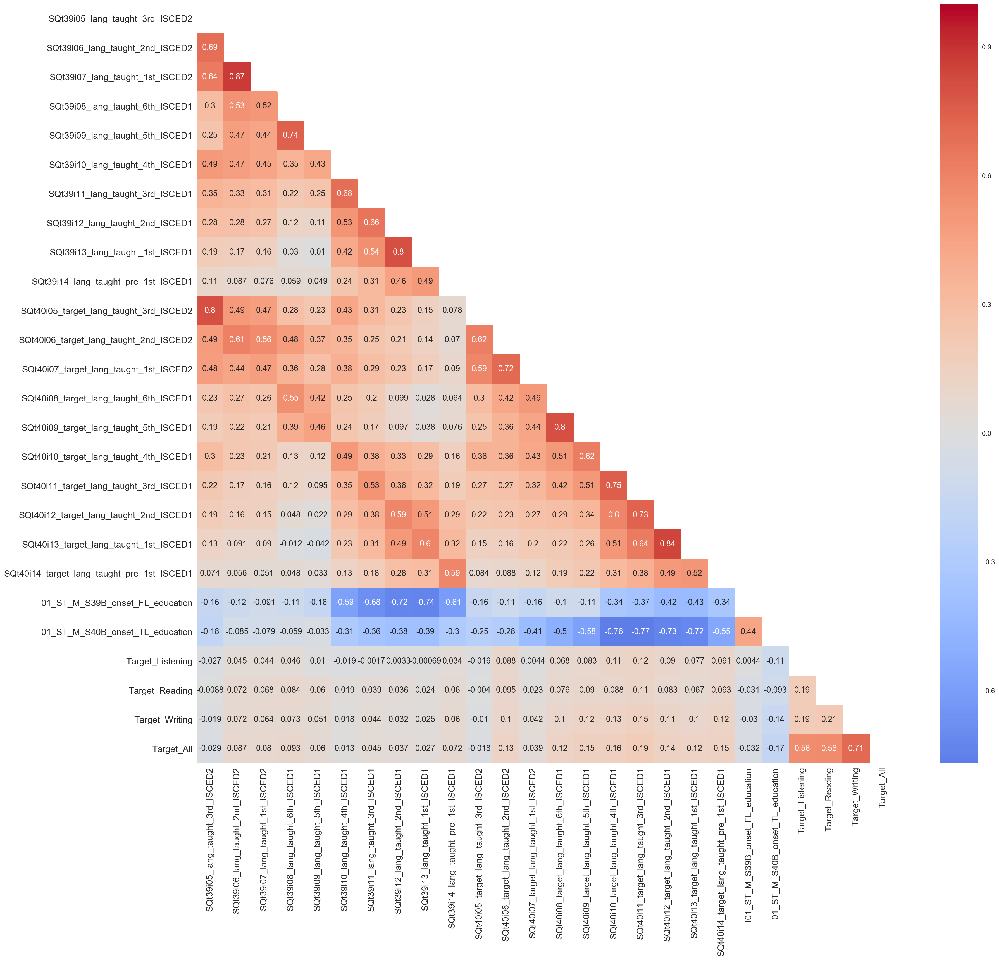

In [281]:
# plot onset heatmap
heatmap_func(onset_corr)

## Socio-Economic Factors

In [282]:
# group home features together
home = [col for col in lang.columns if 'no_of' in col]

In [283]:
# save home data
home_df = lang.loc[:,home]

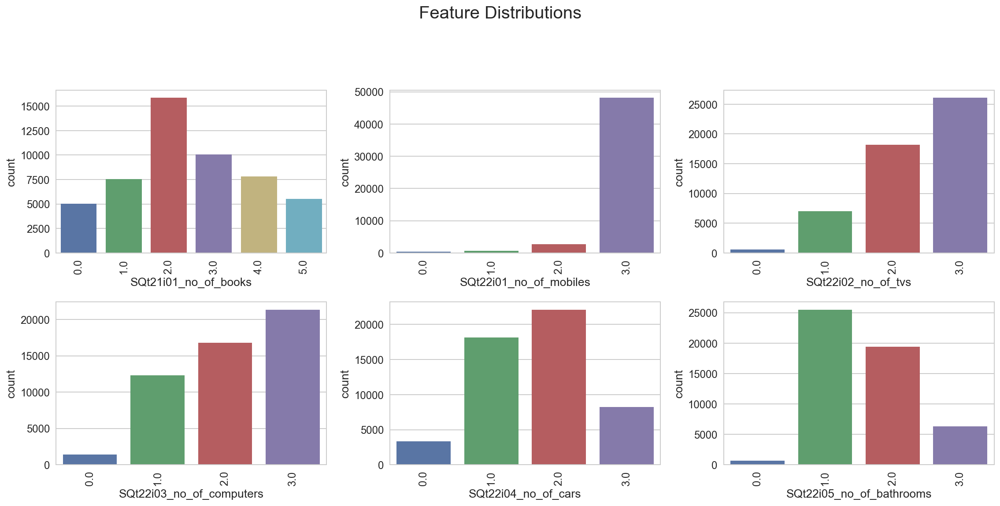

In [284]:
# plot home data
features_fig(home_df)

In [285]:
# function to plot response data for higher number of classes
def classes_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,10))

    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(2,1,j)
        plt.title('Responses for ' + str(i), fontsize=15)
        sns.countplot(x=i, data=data)
        #plt.set_ylabel('Frequency')
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [286]:
# subset to socio-economic features
socio_ec = [col for col in lang.columns if 'socio_economic' in col]

In [287]:
# save socio-economic data
socio_ec_df = lang.loc[:,socio_ec]

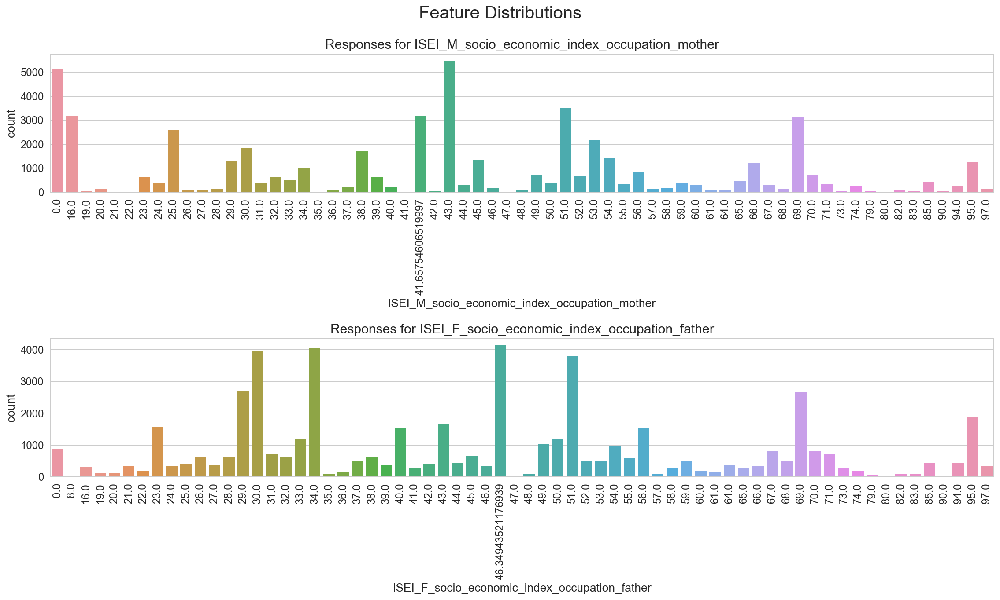

In [288]:
# plot socio-economic data
classes_fig(socio_ec_df)

Note: the data for the socio-economic features indicate responses across a wide range of the available options. I was concerned that the students may not have known sufficient information for this field to be useful but as the responses cover a wide range, I will keep this feature in.

## Parents' Occupations

In [289]:
# convert descriptions to title case
lang.ISCO_M_description = lang.ISCO_M_description.str.title()
lang.ISCO_F_description = lang.ISCO_F_description.str.title()

In [290]:
# group occupations together
occupation = [col for col in lang.columns if 'description' in col\
              and 'ISCO' in col]

In [291]:
# function to plot response data for higher number of classes
def occupations_fig(data):
    # create figure to hold multiple plots  
    plt.figure(figsize=(16,150))
    
    # instantiate the variable for the location of the first subplot 
    j = 1

    # iterate through columns in list and create subplot for the scores in each
    for i in data.columns:
        data.sort_values(i, axis=0, ascending=True, inplace=True)
        plt.subplot(2,1,j)
        plt.title('Responses for ' + str(i), fontsize=15)
        sns.countplot(y=i, data=data, orient='h', order = data[i].value_counts().index)
        #plt.set_ylabel('Frequency')
        plt.xticks(rotation=90)
        j += 1

    plt.tight_layout(rect=[0,0.03,1,0.95])
    plt.suptitle('Feature Distributions', fontsize=20)
    plt.show()

In [292]:
# save occupation data
occupations_df = lang.loc[:,occupation]

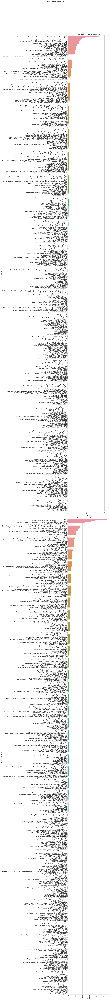

In [293]:
# plot occupation data
occupations_fig(occupations_df)

In [294]:
# merge socio-economic, home and target data for correlations
socio_ec_df = socio_ec_df.merge(home_df, how='left', left_index=True,\
                                right_index=True,suffixes=('', ''))
socio_ec_df = socio_ec_df.merge(occupations_df, how='left', left_index=True,\
                                right_index=True,suffixes=('', ''))
socio_ec_df = socio_ec_df.merge(targets_df, how='left', left_index=True,\
                                right_index=True,suffixes=('', ''))

In [295]:
# create socio-economic correlation matrix
socio_ec_corr = socio_ec_df.corr()

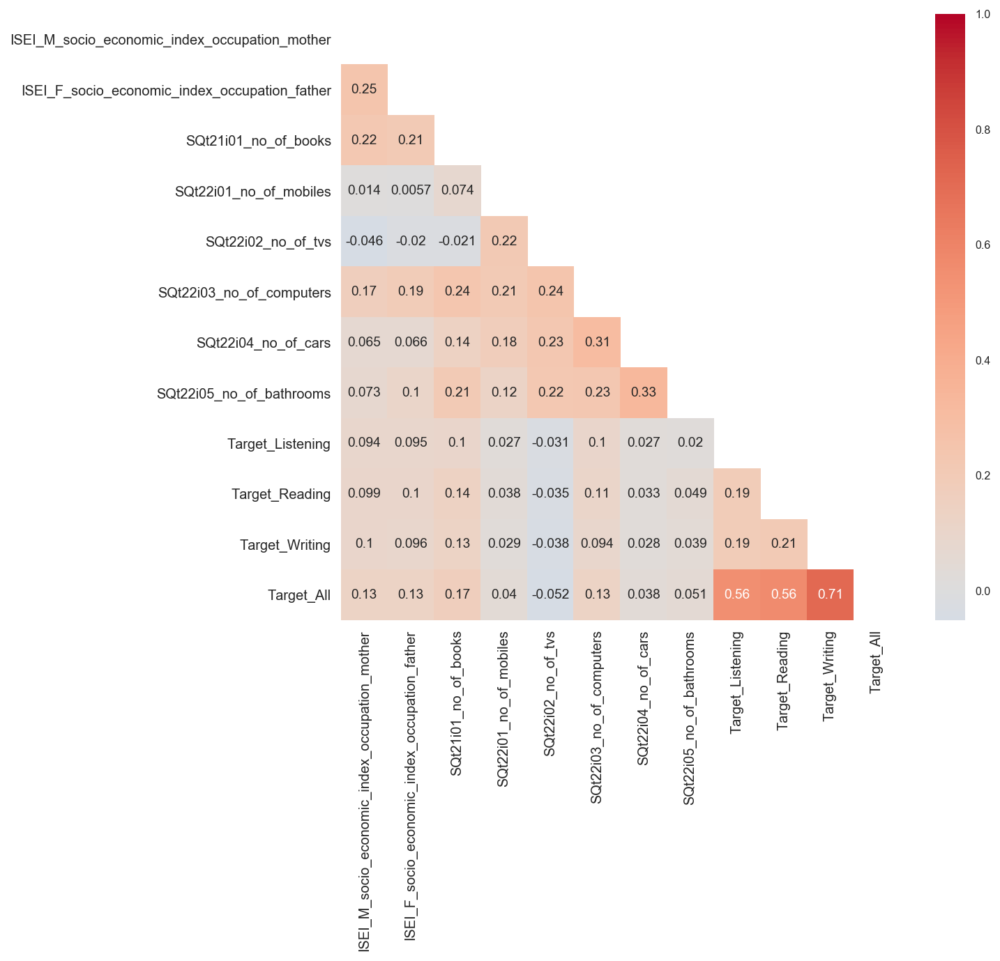

In [296]:
# plot socio-economic heatmap
small_heatmap_func(socio_ec_corr)

## Language Trips

In [297]:
# group language trips/exchanges together
trips = [col for col in lang.columns if 'trip' in col\
         or 'exchange' in col or 'visit' in col]

In [298]:
# save trip data
trips_df = lang.loc[:,trips]

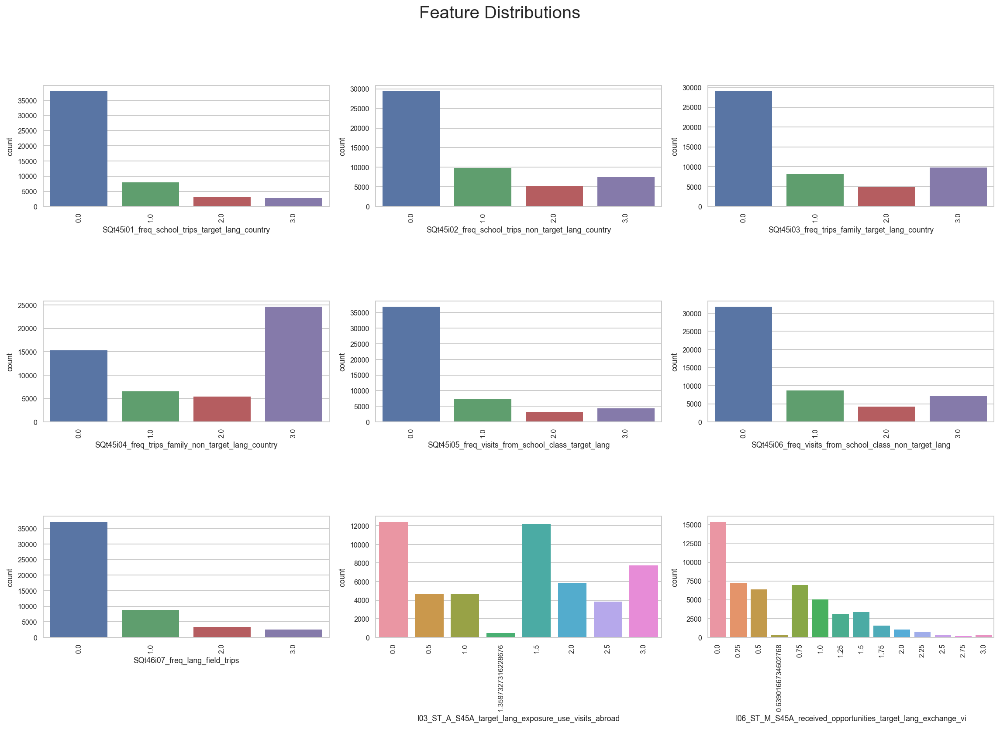

In [299]:
# plot trip data
features_fig(trips_df)

In [300]:
# merge trip and target data for correlations
trips_df = trips_df.merge(targets_df, how='left', left_index=True,\
                          right_index=True,suffixes=('', ''))

In [301]:
# create trip correlation matrix
trips_corr = trips_df.corr()

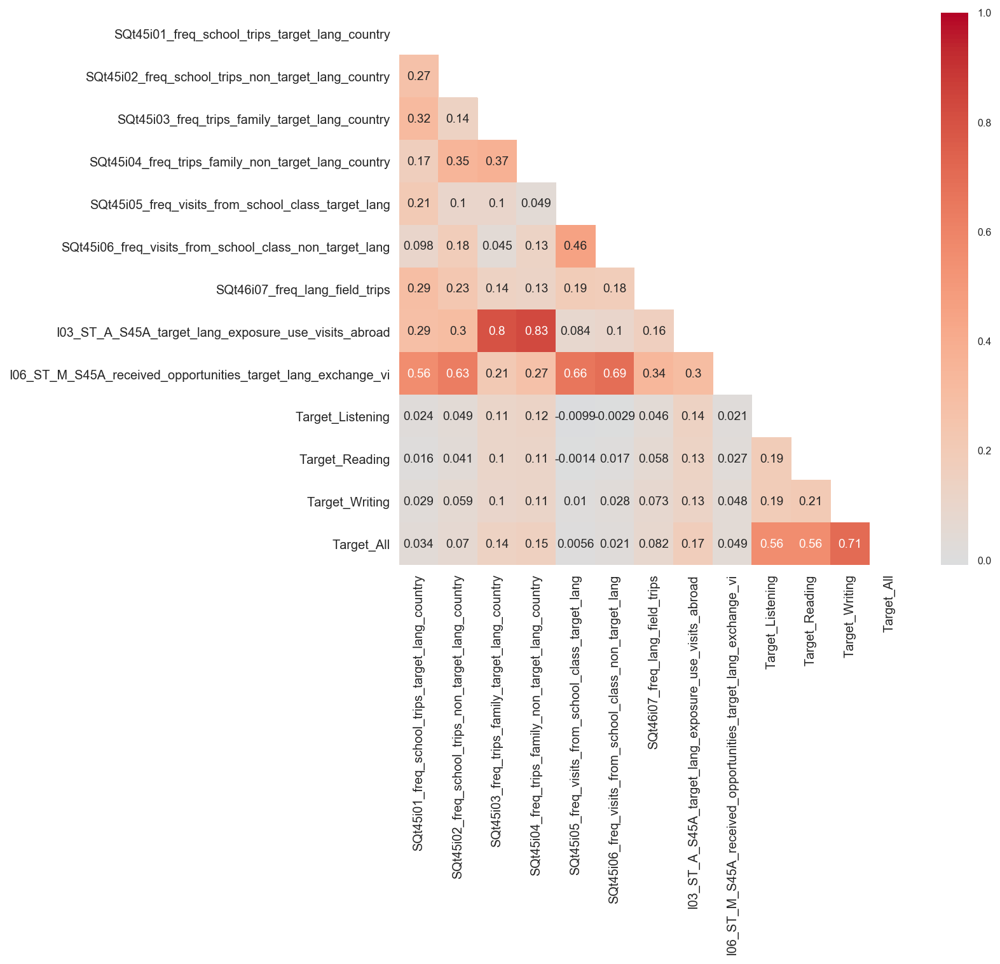

In [302]:
# plot trip heatmap
small_heatmap_func(trips_corr)

## Parental Influence

I am interested to understand whether a parent's education level, employment status or language knowledge has any bearing on their children's ability to learn a language, irrespective of whether they have raised their child as multilingual.

In [305]:
# group features relating to parents' language knowledge together
parent = [col for col in lang.columns if 'mother' in col\
          or 'father' in col or 'parent' in col\
          if 'occupation' not in col]

In [308]:
# save parent data
parent_df = lang.loc[:,parent]

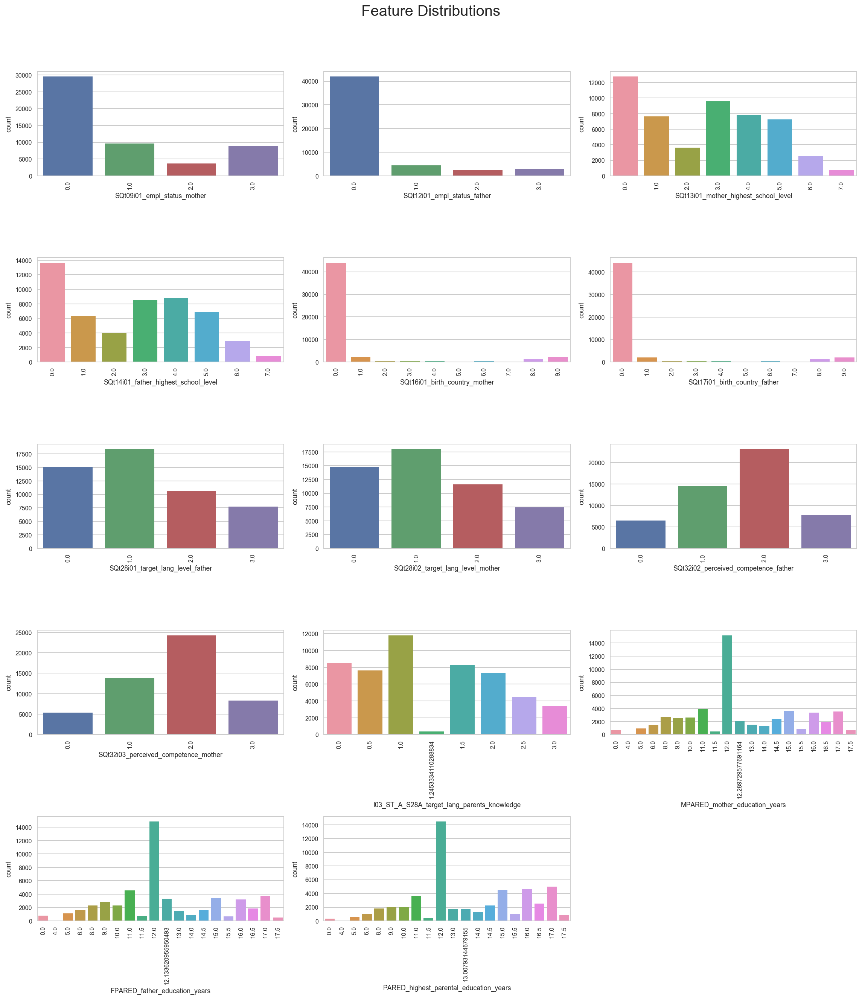

In [309]:
# plot parent data
features_fig(parent_df)

In [312]:
# merge parent and target data for correlations
parent_df = parent_df.merge(targets_df, how='left', left_index=True,\
                            right_index=True,suffixes=('', ''))

In [313]:
# create parent correlation matrix
parent_corr = parent_df.corr()

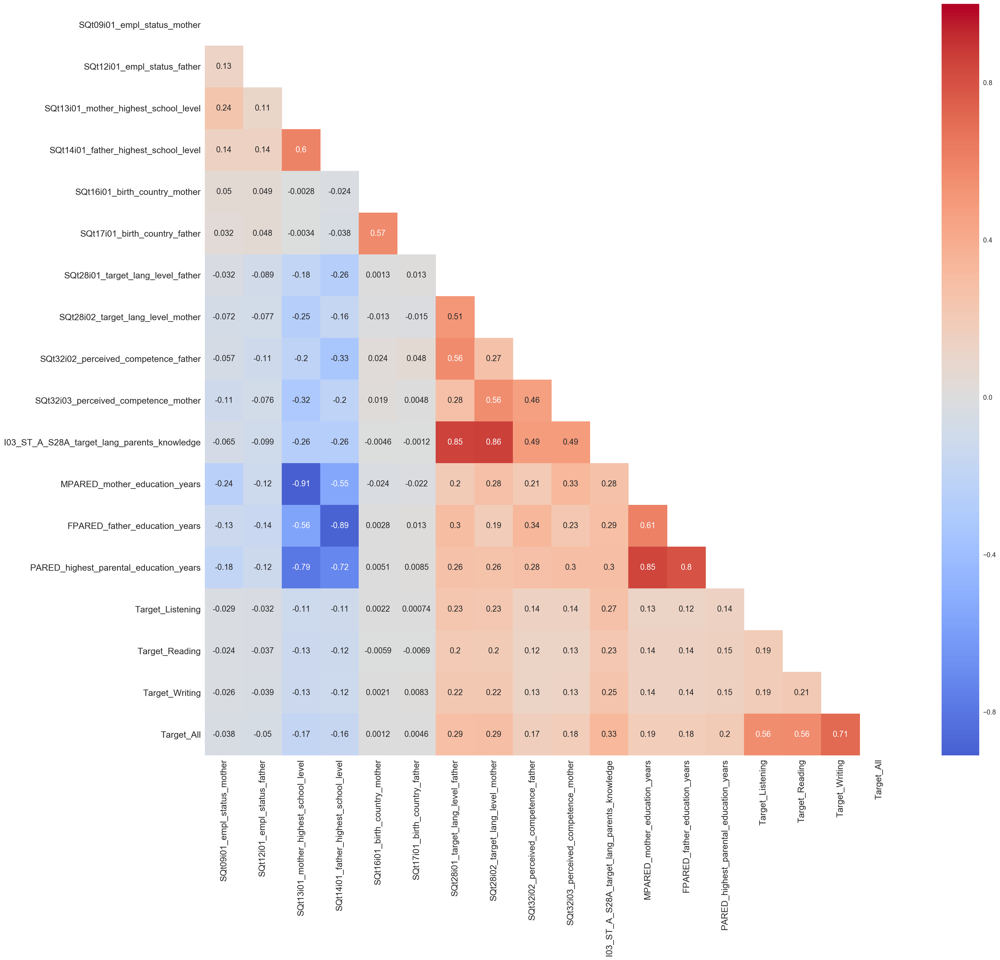

In [314]:
# plot parent heatmap
heatmap_func(parent_corr)

## Perceived Usefulness (only run when time!)

In [323]:
# group usefulness-related features together
usefulness = [col for col in lang.columns if 'usefulness' in col\
             if 'indicator' not in col]

In [325]:
# save usefulness data
usefulness_df = lang.loc[:,usefulness]

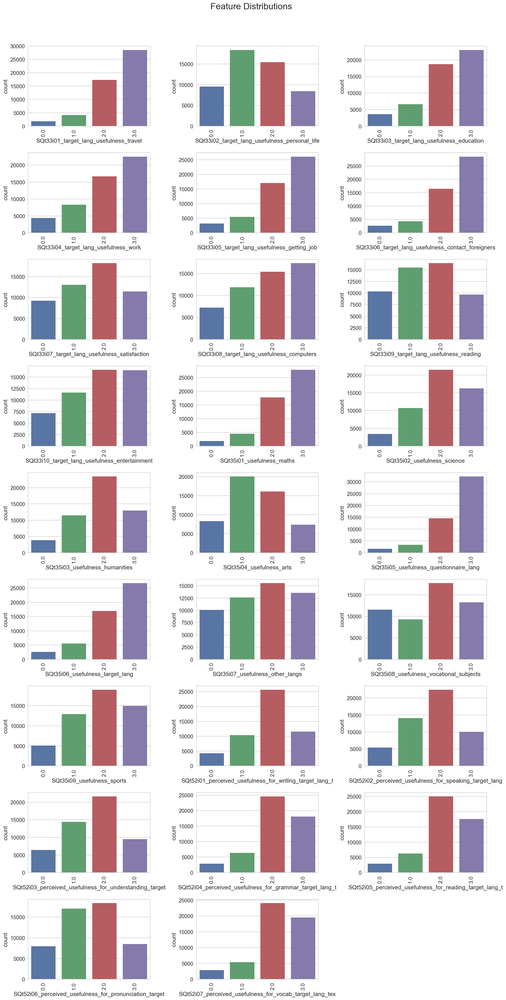

In [326]:
# takes ages so I need to understand why before including it
features_fig(usefulness_df)

In [327]:
# marge usefulness and target data for correlations
usefulness_df = usefulness_df.merge(targets_df, how='left', left_index=True,\
                                    right_index=True,suffixes=('', ''))

In [328]:
# create usefulness correlation matrix
usefulness_corr = usefulness_df.corr()

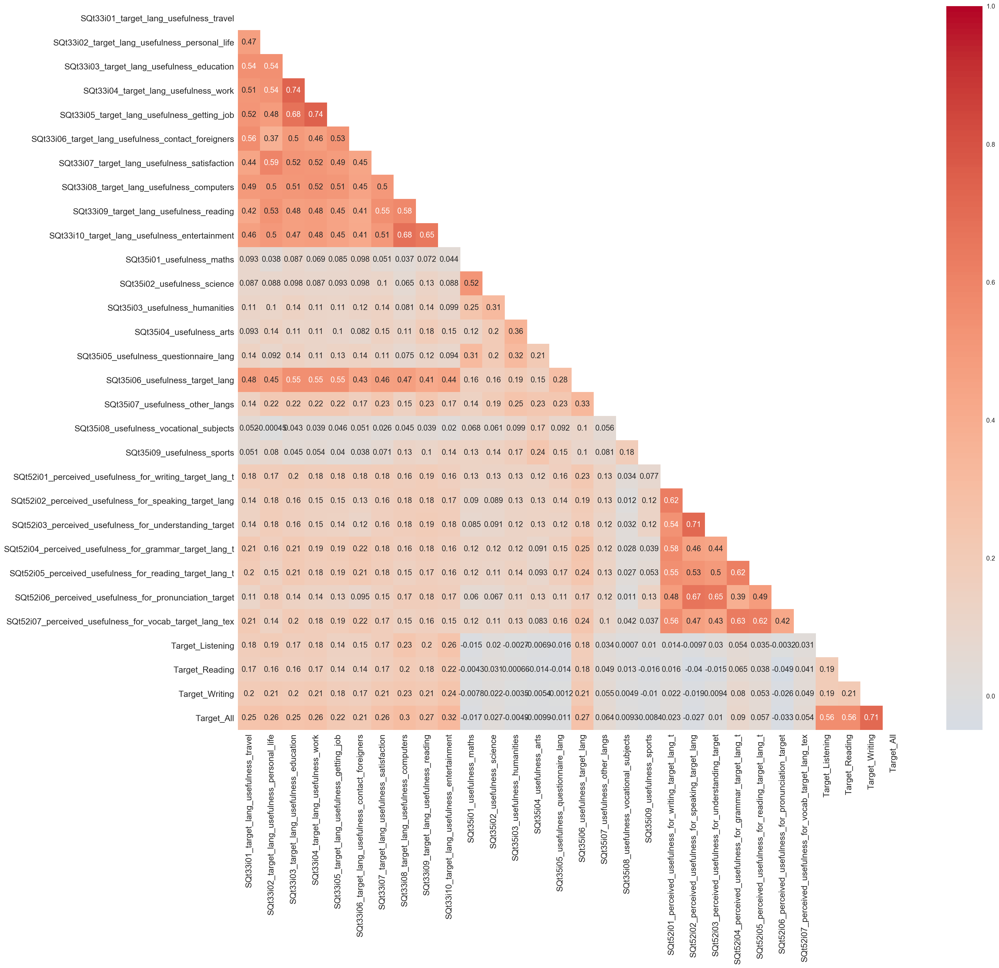

In [329]:
# plot usefulness heatmap
heatmap_func(usefulness_corr)

## Language Competence by Country

In [330]:
# group target data by country
countries = lang.groupby('country')[['Target_Listening', 'Target_Reading',\
                                     'Target_Writing', 'Target_All']].sum()

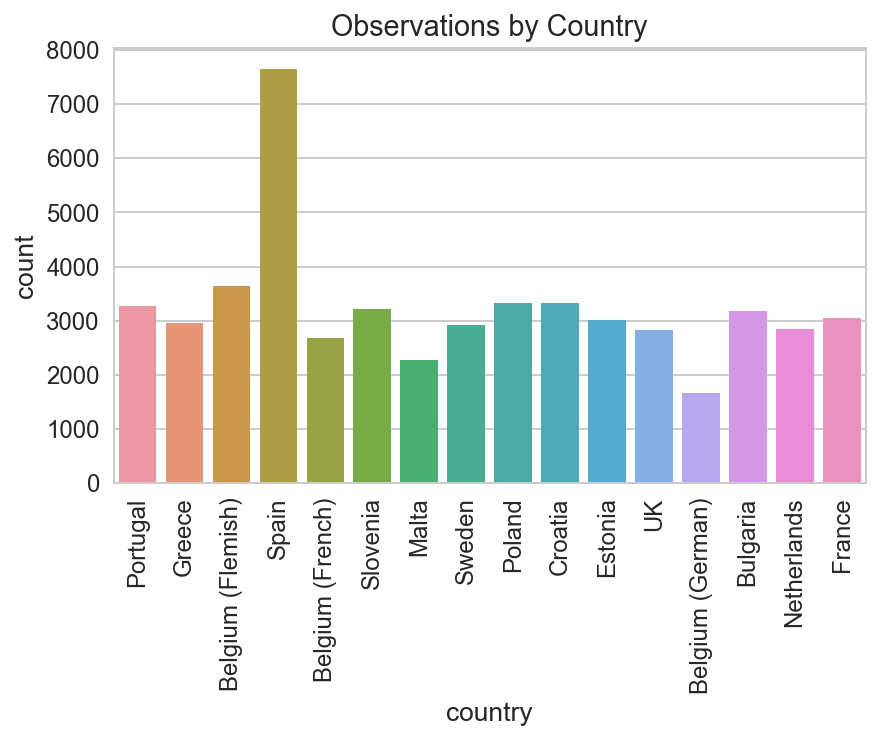

In [333]:
# plot count of observations per country
_ = sns.countplot(x='country', data=lang)
plt.xticks(rotation=90)
plt.title('Observations by Country');

## Export data to .csv

In [334]:
# set path to save csv
path='/Users/lizspiking/DataScience/language-competence/'

# save df to csv
lang.to_csv(path + 'lang_0506.csv', sep=',', na_rep='', float_format=None,\
                 header=True, index=False, mode='w', encoding='UTF-8',\
                 compression=None, quoting=None, quotechar='"',\
                 line_terminator='\n', decimal='.')